In [1]:
import torch
import torch.nn as nn
import torchvision
from torchvision import transforms, datasets
from torch.utils.data import DataLoader, random_split
import matplotlib.pyplot as plt
import zipfile
import os
import numpy as np
from pathlib import Path
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix

Посмотрим на данные:

In [5]:
path = '/home/outcast/study/HSE_DL/images'

folders = [folder for folder in os.listdir(path)]

print(folders)
print(len(folders))

['Budew', 'Hoppip', 'Geodude', 'Ludicolo', 'Golurk', 'Cufant', 'Nidoking', 'Dracozolt', 'Oddish', 'Sneasel', 'Seismitoad', 'Mightyena', 'Shedinja', 'Kubfu', 'Feraligatr', "Farfetch'd", 'Garchomp', 'Torracat', 'Croagunk', 'Mamoswine', 'Bulbasaur', 'Tapu Koko', 'Smeargle', 'Porygon-Z', 'Skiddo', 'Swablu', 'Durant', 'Cottonee', 'Sizzlipede', 'Buneary', 'Blastoise', 'Trevenant', 'Moltres', 'Tapu Lele', 'Delcatty', 'Joltik', 'Weavile', 'Chansey', 'Nosepass', 'Golett', 'Togekiss', 'Seel', 'Bagon', 'Rookidee', 'Dedenne', 'Keldeo', 'Shinx', 'Wishiwashi', 'Heatmor', 'Combee', 'Skiploom', 'Scizor', 'Omastar', 'Lilligant', 'Chespin', 'Venipede', 'Ledian', 'Regirock', 'Klang', 'Gyarados', 'Girafarig', 'Walrein', 'Plusle', 'Basculin', 'Forretress', 'Noibat', 'Bidoof', 'Swirlix', 'Crabrawler', 'Bergmite', 'Bellsprout', 'Exeggcute', 'Swadloon', 'Cofagrigus', 'Toxtricity', 'Pineco', 'Ampharos', 'Haxorus', 'Inkay', 'Flabébé', 'Trumbeak', 'Zacian', 'Minior', 'Hitmonchan', 'Gallade', 'Zubat', 'Type Null'

Реализуем класс датасета

In [6]:

full_dataset = datasets.ImageFolder(
    root=path,
    transform=None
)

class PokemonDataset(torch.utils.data.Dataset):
    def __init__(self, dataset):
        self.dataset = dataset
        self.transform = transforms.Compose([
            transforms.Resize((128, 128)),
            transforms.RandomRotation(degrees=30),
            transforms.RandomHorizontalFlip(p=0.5),
            transforms.ToTensor(),
            transforms.Normalize(
                mean=[0.485, 0.456, 0.406], 
                std=[0.229, 0.224, 0.225]
            ),
        ])

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        img, label = self.dataset[idx]
        return self.transform(img), label

dataset = PokemonDataset(full_dataset)

In [7]:
train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size
train_data, test_data = random_split(dataset, [train_size, test_size])

train_loader = DataLoader(train_data, batch_size=32, shuffle=True)
test_loader = DataLoader(test_data, batch_size=32, shuffle = False)

Даталоадер правильно работает. Перейдем к архитектуре:

In [68]:
class SimpleNet(nn.Module):
    def __init__(self, num_classes = 898):
        super().__init__()
        self.layers = nn.Sequential(
            nn.Conv2d(3, 8, 3, padding='same'),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),
            nn.Conv2d(8, 16, 3, padding='same'),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),
            nn.Conv2d(16, 32, 3, padding='same'),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),
            nn.Flatten(),
            nn.Linear(8192, 1024),
            nn.ReLU(),
            nn.Linear(1024, 128),
            nn.ReLU(),
            nn.Linear(128, num_classes)
        )

    def forward(self, x):
        return self.layers(x)

Cкрипт валидации:

In [69]:
def validate_model(model, val_loader, device):
    model.eval()
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, preds = torch.max(outputs, 1)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    accuracy = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds, average='weighted')

    return accuracy, f1

Обучим модель:

In [73]:
device = "cuda"

model = SimpleNet().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

num_epoch = 40
best_score = 0.0
state_dict = None

loss_arr = []
accuracy_arr = []
f1_arr = []


for epoch in range(num_epoch):
    model.train()
    epoch_loss = 0.0

    # Обучение
    for i, (images, labels) in enumerate(train_loader):
        images, labels = images.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()
        loss_arr.append(loss.item())

    # Средний лосс за эпоху
    avg_epoch_loss = epoch_loss / len(train_loader)
    print(f'\nEpoch [{epoch+1}/{num_epoch}] Training Loss: {avg_epoch_loss:.4f}')

    # Валидация
    val_accuracy, val_f1 = validate_model(model, test_loader, device)

    accuracy_arr.append(val_accuracy)
    f1_arr.append(val_f1)

    print(f'Accuracy: {val_accuracy:.4f} | F1-score: {val_f1:.4f}')

    if val_f1 >= best_score:
        state_dict = model.state_dict().copy()

torch.save(state_dict, 'pokemon_classifier.pth')


Epoch [1/40] Training Loss: 6.8153
Accuracy: 0.0020 | F1-score: 0.0000

Epoch [2/40] Training Loss: 6.7906
Accuracy: 0.0000 | F1-score: 0.0000

Epoch [3/40] Training Loss: 6.7576
Accuracy: 0.0000 | F1-score: 0.0000

Epoch [4/40] Training Loss: 6.6995
Accuracy: 0.0020 | F1-score: 0.0000

Epoch [5/40] Training Loss: 6.5304
Accuracy: 0.0020 | F1-score: 0.0002

Epoch [6/40] Training Loss: 6.3023
Accuracy: 0.0000 | F1-score: 0.0000

Epoch [7/40] Training Loss: 6.1213
Accuracy: 0.0040 | F1-score: 0.0014

Epoch [8/40] Training Loss: 5.8822
Accuracy: 0.0000 | F1-score: 0.0000

Epoch [9/40] Training Loss: 5.6033
Accuracy: 0.0100 | F1-score: 0.0047

Epoch [10/40] Training Loss: 5.3200
Accuracy: 0.0160 | F1-score: 0.0098

Epoch [11/40] Training Loss: 4.9716
Accuracy: 0.0100 | F1-score: 0.0039

Epoch [12/40] Training Loss: 4.6943
Accuracy: 0.0180 | F1-score: 0.0111

Epoch [13/40] Training Loss: 4.3659
Accuracy: 0.0279 | F1-score: 0.0196

Epoch [14/40] Training Loss: 4.1042
Accuracy: 0.0399 | F1-s

Построим графики

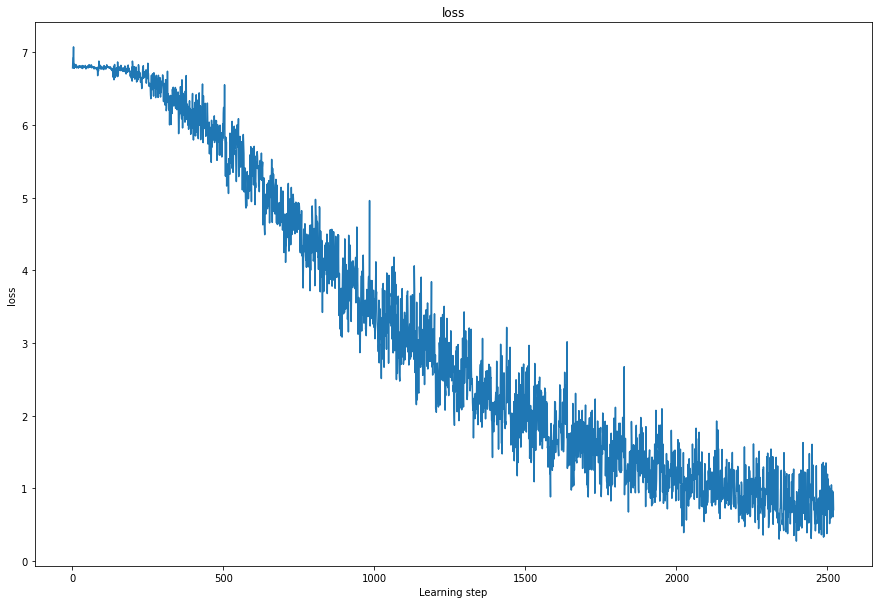

In [88]:
plt.figure(figsize=(15, 10))
plt.plot([i + 1 for i in range(len(loss_arr))], loss_arr)
plt.xlabel('Learning step')
plt.ylabel('loss')
plt.title('loss')
plt.show()

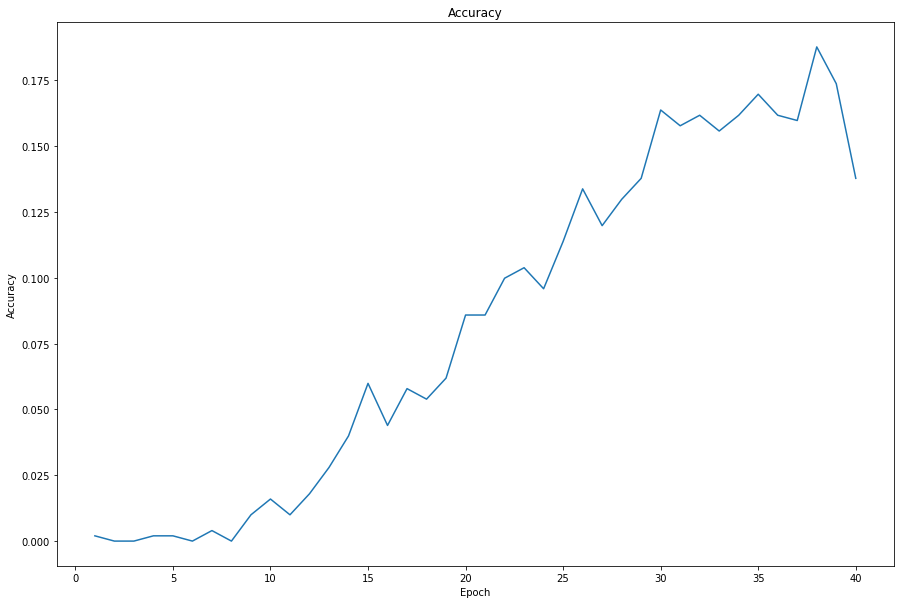

In [90]:
plt.figure(figsize=(15, 10))
plt.plot([i + 1 for i in range(len(accuracy_arr))], accuracy_arr)
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy')
plt.show()

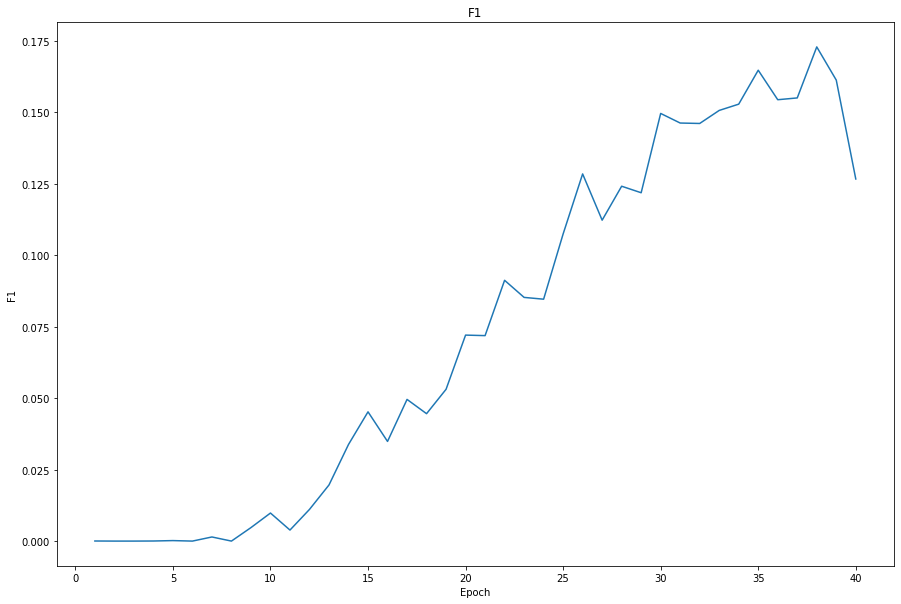

In [91]:
plt.figure(figsize=(15, 10))
plt.plot([i + 1 for i in range(len(f1_arr))], f1_arr)
plt.xlabel('Epoch')
plt.ylabel('F1')
plt.title('F1')
plt.show()

Загрузим модель, проверим предикты:

In [92]:
model = SimpleNet().to(device)
model.load_state_dict(torch.load('pokemon_classifier.pth'))
model.eval()

SimpleNet(
  (layers): Sequential(
    (0): Conv2d(3, 8, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(8, 16, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (4): ReLU()
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (7): ReLU()
    (8): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (9): Flatten(start_dim=1, end_dim=-1)
    (10): Linear(in_features=8192, out_features=1024, bias=True)
    (11): ReLU()
    (12): Linear(in_features=1024, out_features=128, bias=True)
    (13): ReLU()
    (14): Linear(in_features=128, out_features=898, bias=True)
  )
)

Номер элемента: 0
Истинный класс: Regidrago
Dustox (62.67%)
Morpeko (12.21%)
Tornadus (5.09%)


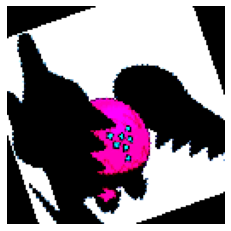

Номер элемента: 1
Истинный класс: Clefairy
Linoone (80.88%)
Nincada (7.67%)
Clefairy (3.93%)


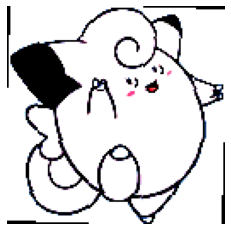

Номер элемента: 2
Истинный класс: Chatot
Morpeko (96.20%)
Copperajah (2.75%)
Vivillon (0.46%)


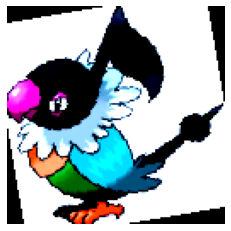

Номер элемента: 3
Истинный класс: Dartrix
Blaziken (71.96%)
Oricorio (23.36%)
Raichu (2.02%)


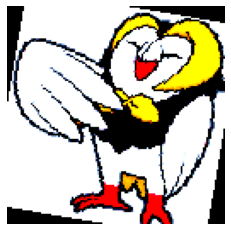

Номер элемента: 4
Истинный класс: Barbaracle
Anorith (49.45%)
Golem (24.19%)
Yanmega (6.62%)


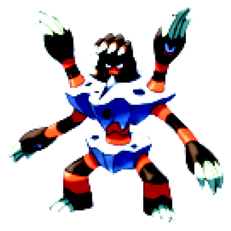

Номер элемента: 5
Истинный класс: Hypno
Drowzee (30.40%)
Paras (11.26%)
Jolteon (9.18%)


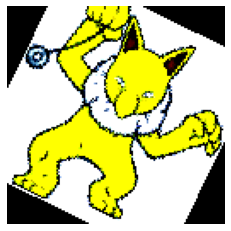

Номер элемента: 6
Истинный класс: Venomoth
Dusclops (37.20%)
Weezing (21.07%)
Arceus (20.95%)


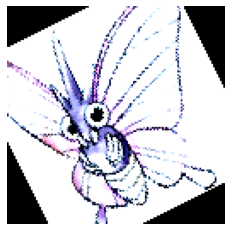

Номер элемента: 7
Истинный класс: Mewtwo
Linoone (42.20%)
Solgaleo (18.35%)
Unown (10.26%)


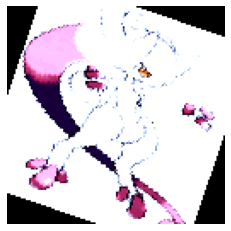

Номер элемента: 8
Истинный класс: Aegislash
Aegislash (54.31%)
Starmie (20.81%)
Kangaskhan (9.59%)


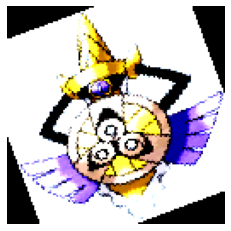

Номер элемента: 9
Истинный класс: Heliolisk
Turtwig (66.81%)
Nickit (17.18%)
Heliolisk (7.64%)


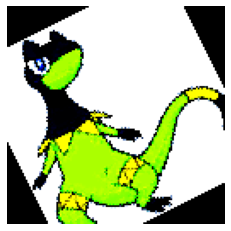

Номер элемента: 10
Истинный класс: Tyranitar
Wooloo (53.88%)
Rockruff (20.57%)
Mimikyu (7.24%)


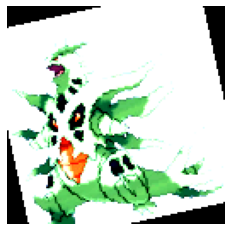

Номер элемента: 11
Истинный класс: Houndour
Golbat (52.82%)
Cloyster (10.20%)
Kyurem (10.02%)


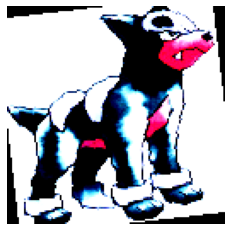

Номер элемента: 12
Истинный класс: Nidoran♀
Persian (97.22%)
Articuno (0.88%)
Mr. Mime (0.65%)


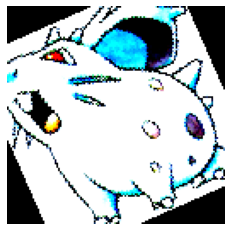

Номер элемента: 13
Истинный класс: Honchkrow
Wailmer (34.02%)
Cosmog (17.45%)
Dracovish (15.40%)


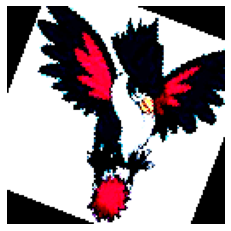

Номер элемента: 14
Истинный класс: Skrelp
Skrelp (36.29%)
Shroomish (15.54%)
Solgaleo (11.59%)


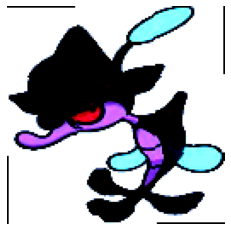

Номер элемента: 15
Истинный класс: Venonat
Bulbasaur (56.44%)
Morpeko (13.59%)
Venusaur (12.25%)


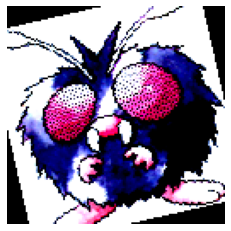

Номер элемента: 16
Истинный класс: Chikorita
Steenee (74.12%)
Kirlia (4.00%)
Shiinotic (3.53%)


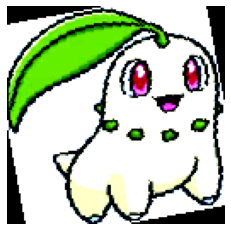

Номер элемента: 17
Истинный класс: Gligar
Latias (81.33%)
Lunala (10.39%)
Gligar (3.62%)


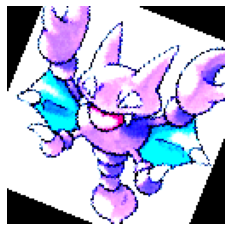

Номер элемента: 18
Истинный класс: Petilil
Cacturne (33.72%)
Persian (29.21%)
Qwilfish (15.93%)


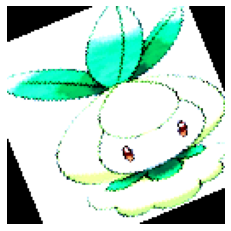

Номер элемента: 19
Истинный класс: Oshawott
Lugia (67.10%)
Lapras (13.42%)
Golbat (11.13%)


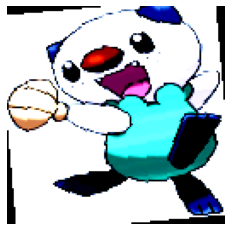

Номер элемента: 20
Истинный класс: Dewott
Seadra (92.08%)
Wooper (4.05%)
Beldum (2.33%)


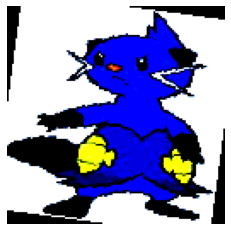

Номер элемента: 21
Истинный класс: Relicanth
Banette (33.34%)
Duskull (32.67%)
Pangoro (10.55%)


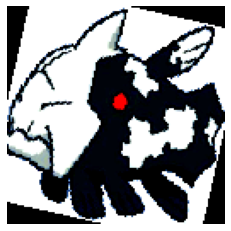

Номер элемента: 22
Истинный класс: Alakazam
Flapple (31.73%)
Rotom (17.49%)
Heatran (14.30%)


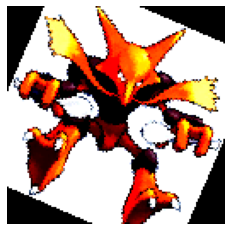

Номер элемента: 23
Истинный класс: Tapu Koko
Volcanion (45.49%)
Tapu Koko (20.20%)
Groudon (17.70%)


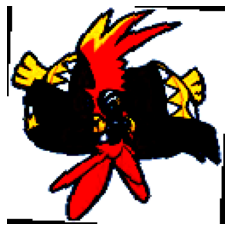

Номер элемента: 24
Истинный класс: Palpitoad
Blastoise (42.42%)
Clamperl (36.38%)
Zeraora (9.90%)


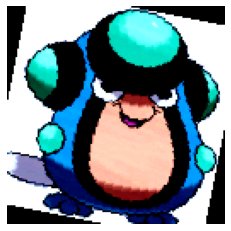

Номер элемента: 25
Истинный класс: Stonjourner
Snover (36.18%)
Tympole (27.19%)
Marowak (11.43%)


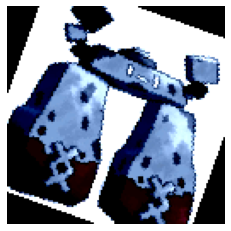

Номер элемента: 26
Истинный класс: Raticate
Staryu (40.53%)
Weepinbell (14.02%)
Torchic (13.98%)


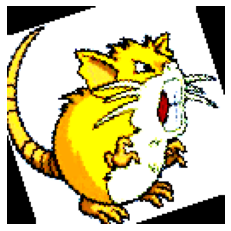

Номер элемента: 27
Истинный класс: Skiploom
Appletun (60.62%)
Lilligant (24.08%)
Kabuto (14.31%)


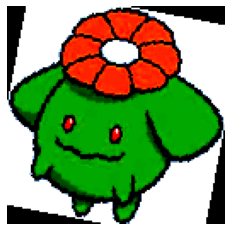

Номер элемента: 28
Истинный класс: Skorupi
Ducklett (55.61%)
Snorlax (37.28%)
Kecleon (4.83%)


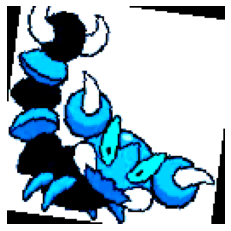

Номер элемента: 29
Истинный класс: Swampert
Nidoqueen (93.26%)
Carracosta (3.11%)
Wartortle (2.78%)


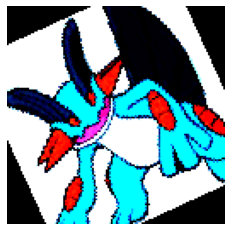

Номер элемента: 30
Истинный класс: Rhyhorn
Furfrou (76.69%)
Dratini (3.95%)
Omanyte (3.47%)


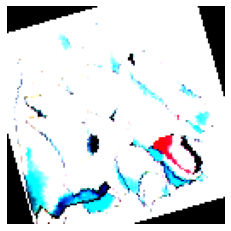

Номер элемента: 31
Истинный класс: Komala
Jigglypuff (48.93%)
Aerodactyl (19.83%)
Remoraid (17.30%)


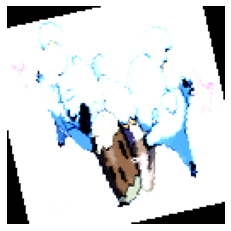

Номер элемента: 0
Истинный класс: Monferno
Pawniard (44.82%)
Rotom (36.34%)
Cinderace (3.16%)


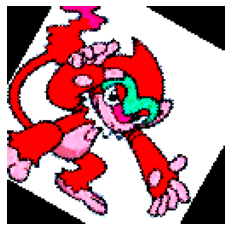

Номер элемента: 1
Истинный класс: Burmy
Burmy (98.04%)
Wormadam (1.39%)
Torkoal (0.17%)


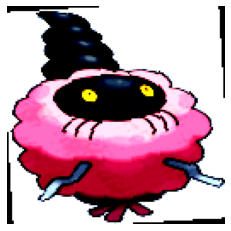

Номер элемента: 2
Истинный класс: Thundurus
Vibrava (99.51%)
Skiddo (0.36%)
Basculin (0.05%)


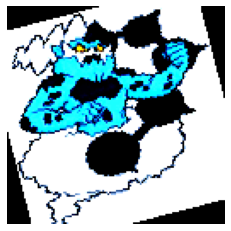

Номер элемента: 3
Истинный класс: Petilil
Eelektrik (33.00%)
Victreebel (27.96%)
Exeggutor (15.19%)


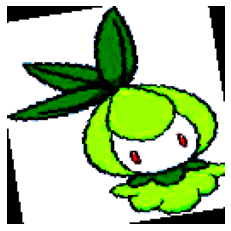

Номер элемента: 4
Истинный класс: Passimian
Zebstrika (73.15%)
Necrozma (10.74%)
Obstagoon (4.40%)


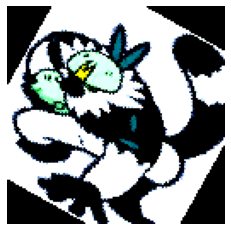

Номер элемента: 5
Истинный класс: Pignite
Pignite (21.09%)
Camerupt (18.91%)
Pikachu (14.15%)


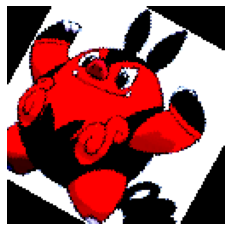

Номер элемента: 6
Истинный класс: Poliwrath
Grovyle (51.78%)
Golisopod (11.54%)
Linoone (8.15%)


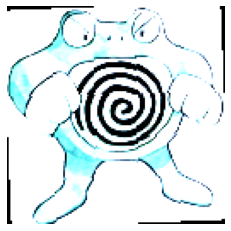

Номер элемента: 7
Истинный класс: Magnezone
Arceus (28.89%)
Shaymin (15.05%)
Jigglypuff (11.16%)


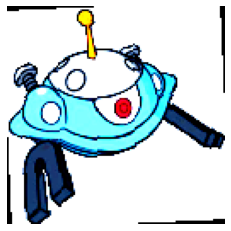

Номер элемента: 8
Истинный класс: Magmar
Pikachu (67.70%)
Scyther (12.53%)
Growlithe (6.16%)


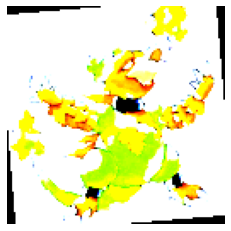

Номер элемента: 9
Истинный класс: Ekans
Shelmet (37.07%)
Ariados (31.18%)
Crawdaunt (18.81%)


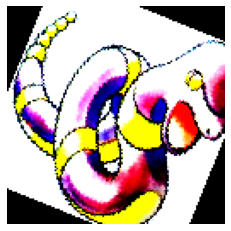

Номер элемента: 10
Истинный класс: Castform
Parasect (89.60%)
Paras (8.11%)
Torchic (0.62%)


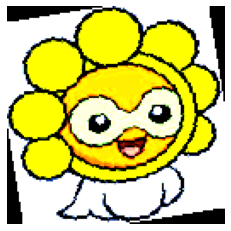

Номер элемента: 11
Истинный класс: Torchic
Torchic (83.15%)
Drowzee (7.27%)
Parasect (4.82%)


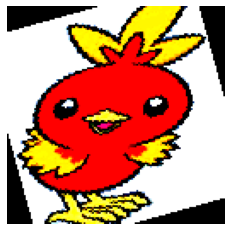

Номер элемента: 12
Истинный класс: Deerling
Dragalge (33.88%)
Sawsbuck (27.95%)
Kirlia (14.15%)


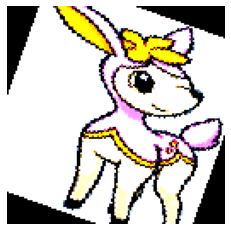

Номер элемента: 13
Истинный класс: Slowpoke
Mienfoo (17.31%)
Slowpoke (10.33%)
Wurmple (9.33%)


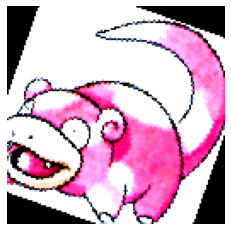

Номер элемента: 14
Истинный класс: Salazzle
Salazzle (41.25%)
Giratina (21.04%)
Mawile (9.57%)


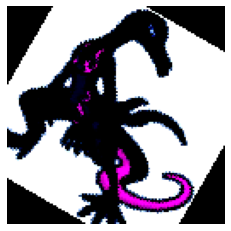

Номер элемента: 15
Истинный класс: Scizor
Scizor (58.12%)
Paras (20.80%)
Incineroar (6.11%)


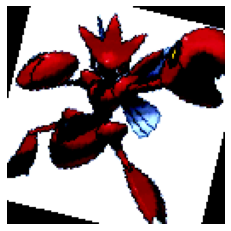

Номер элемента: 16
Истинный класс: Drowzee
Sunflora (94.82%)
Kabuto (2.63%)
Leavanny (1.22%)


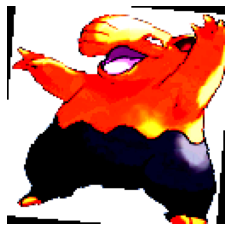

Номер элемента: 17
Истинный класс: Electivire
Zeraora (82.39%)
Zygarde (9.75%)
Electivire (3.00%)


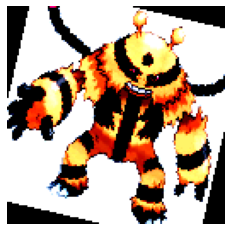

Номер элемента: 18
Истинный класс: Tepig
Tepig (99.96%)
Victreebel (0.01%)
Camerupt (0.01%)


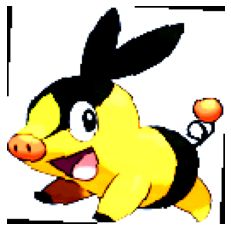

Номер элемента: 19
Истинный класс: Delphox
Scraggy (27.71%)
Kecleon (19.64%)
Victreebel (15.69%)


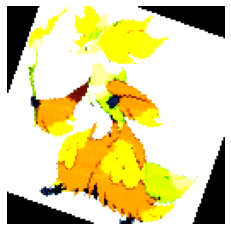

Номер элемента: 20
Истинный класс: Metagross
Wailmer (94.74%)
Metagross (4.34%)
Dracovish (0.88%)


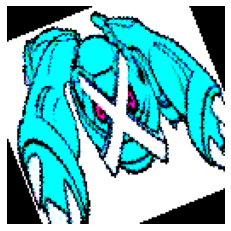

Номер элемента: 21
Истинный класс: Zubat
Lampent (60.37%)
Wigglytuff (13.96%)
Hatterene (10.62%)


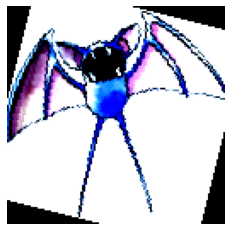

Номер элемента: 22
Истинный класс: Pumpkaboo
Pumpkaboo (99.39%)
Seedot (0.36%)
Zygarde (0.07%)


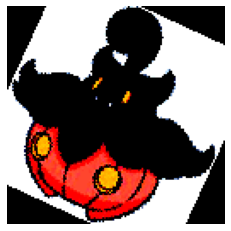

Номер элемента: 23
Истинный класс: Kangaskhan
Volcanion (31.45%)
Camerupt (18.97%)
Zeraora (16.65%)


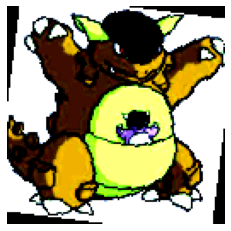

Номер элемента: 24
Истинный класс: Weedle
Rapidash (42.76%)
Lickitung (8.30%)
Alcremie (7.74%)


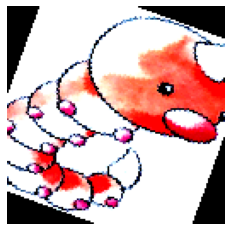

Номер элемента: 25
Истинный класс: Octillery
Hypno (56.30%)
Ninetales (22.93%)
Pidgeot (4.88%)


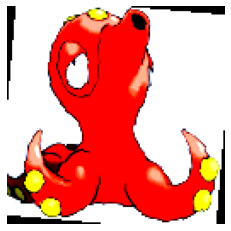

Номер элемента: 26
Истинный класс: Stunfisk
Swinub (95.20%)
Natu (1.86%)
Grubbin (0.52%)


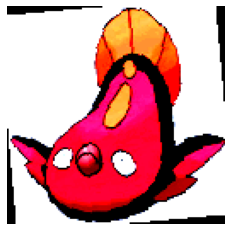

Номер элемента: 27
Истинный класс: Gardevoir
Linoone (53.38%)
Minccino (19.91%)
Smeargle (6.10%)


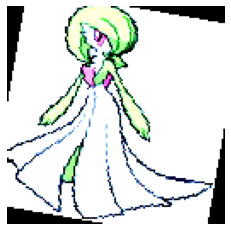

Номер элемента: 28
Истинный класс: Lugia
Latios (67.89%)
Brionne (6.97%)
Heracross (5.73%)


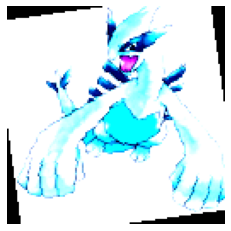

Номер элемента: 29
Истинный класс: Volbeat
Illumise (86.39%)
Croconaw (7.76%)
Probopass (1.32%)


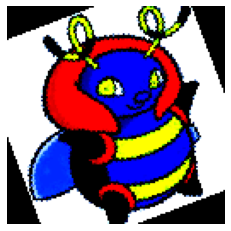

Номер элемента: 30
Истинный класс: Omastar
Snorlax (47.55%)
Seviper (44.67%)
Blastoise (3.90%)


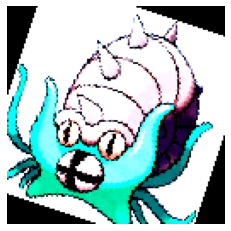

Номер элемента: 31
Истинный класс: Surskit
Ninetales (61.65%)
Wigglytuff (25.49%)
Nidoran♂ (3.60%)


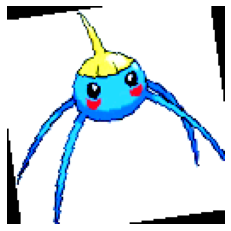

Номер элемента: 0
Истинный класс: Krabby
Alakazam (37.01%)
Pidgeot (33.14%)
Kabutops (11.95%)


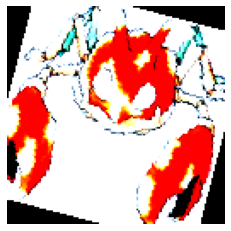

Номер элемента: 1
Истинный класс: Anorith
Hydreigon (33.45%)
Basculin (25.15%)
Unfezant (7.16%)


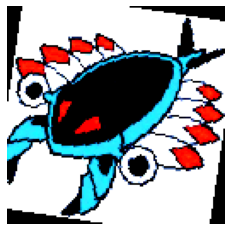

Номер элемента: 2
Истинный класс: Golurk
Eelektross (67.72%)
Grapploct (12.80%)
Golett (3.82%)


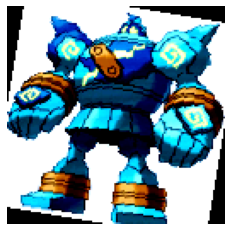

Номер элемента: 3
Истинный класс: Charjabug
Torterra (94.87%)
Vibrava (3.23%)
Tropius (1.73%)


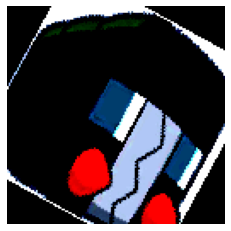

Номер элемента: 4
Истинный класс: Charizard
Cranidos (45.38%)
Tornadus (34.02%)
Riolu (10.20%)


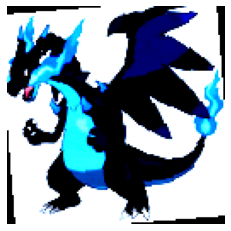

Номер элемента: 5
Истинный класс: Magneton
Magneton (57.71%)
Magnemite (24.24%)
Tornadus (8.45%)


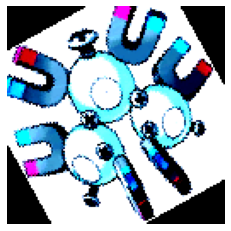

Номер элемента: 6
Истинный класс: Hippowdon
Rhyperior (61.40%)
Crustle (13.32%)
Tapu Lele (6.35%)


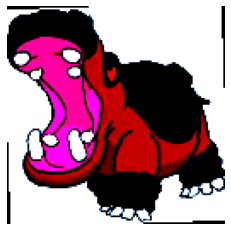

Номер элемента: 7
Истинный класс: Rillaboom
Morpeko (74.67%)
Mawile (8.92%)
Giratina (8.67%)


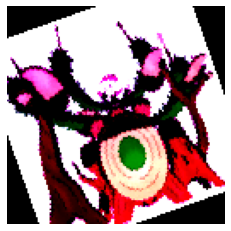

Номер элемента: 8
Истинный класс: Shellos
Honedge (47.05%)
Piplup (38.39%)
Florges (14.14%)


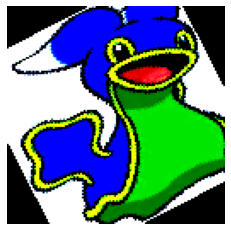

Номер элемента: 9
Истинный класс: Mime Jr
Simisage (25.06%)
Nidoran♀ (22.20%)
Nidoran♂ (16.60%)


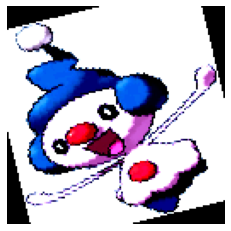

Номер элемента: 10
Истинный класс: Musharna
Ditto (96.11%)
Munna (0.86%)
Ekans (0.75%)


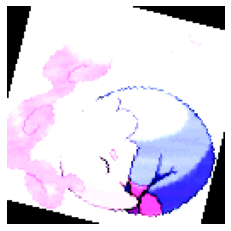

Номер элемента: 11
Истинный класс: Kricketune
Gourgeist (48.55%)
Pyroar (47.27%)
Landorus (3.36%)


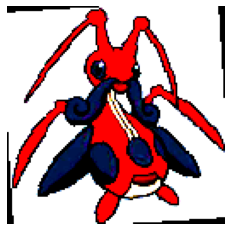

Номер элемента: 12
Истинный класс: Hitmonlee
Arbok (34.54%)
Kabutops (25.57%)
Pidgeot (10.03%)


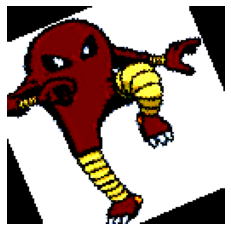

Номер элемента: 13
Истинный класс: Rattata
Arbok (72.11%)
Machoke (26.38%)
Noibat (0.24%)


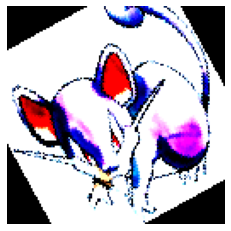

Номер элемента: 14
Истинный класс: Politoed
Camerupt (54.67%)
Zygarde (19.87%)
Tepig (6.06%)


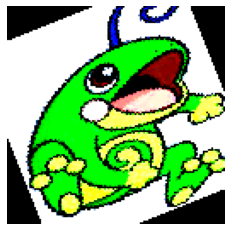

Номер элемента: 15
Истинный класс: Tyrunt
Sandaconda (46.51%)
Tyrunt (38.96%)
Terrakion (13.09%)


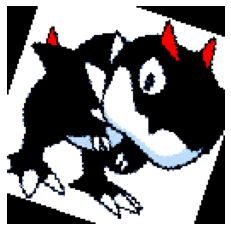

Номер элемента: 16
Истинный класс: Keldeo
Greninja (69.14%)
Suicune (20.59%)
Toxicroak (9.82%)


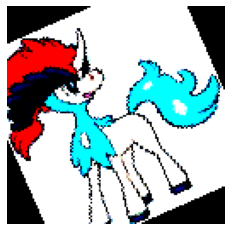

Номер элемента: 17
Истинный класс: Venomoth
Silcoon (28.36%)
Hoopa (20.41%)
Weezing (9.27%)


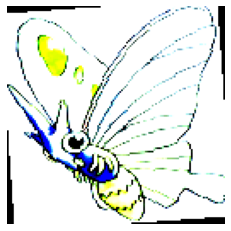

Номер элемента: 18
Истинный класс: Starmie
Weepinbell (73.40%)
Sunkern (5.50%)
Pikachu (4.23%)


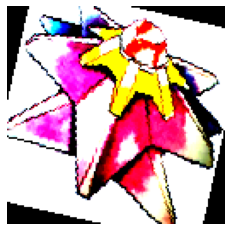

Номер элемента: 19
Истинный класс: Tyranitar
Shelgon (32.52%)
Silvally (22.54%)
Jangmo-o (18.81%)


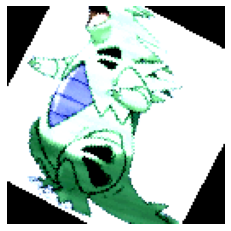

Номер элемента: 20
Истинный класс: Dratini
Meowstic (87.52%)
Duraludon (5.80%)
Vanilluxe (3.10%)


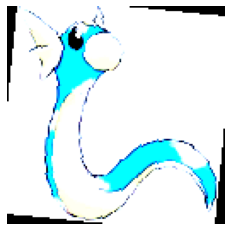

Номер элемента: 21
Истинный класс: Malamar
Hatterene (49.93%)
Machoke (17.85%)
Skuntank (8.52%)


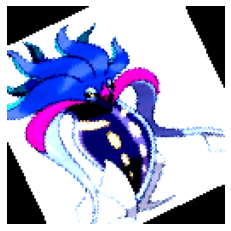

Номер элемента: 22
Истинный класс: Sawsbuck
Chikorita (67.78%)
Sawsbuck (30.98%)
Deerling (1.10%)


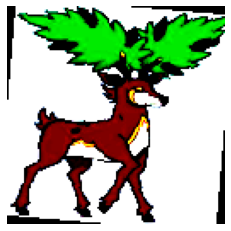

Номер элемента: 23
Истинный класс: Ducklett
Snorlax (28.78%)
Pancham (26.98%)
Geodude (20.43%)


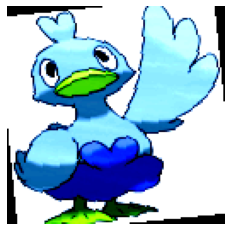

Номер элемента: 24
Истинный класс: Lickilicky
Piloswine (38.17%)
Greedent (12.34%)
Dustox (11.01%)


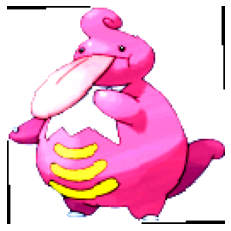

Номер элемента: 25
Истинный класс: Deoxys
Toxtricity (62.67%)
Slowbro (13.69%)
Gligar (9.09%)


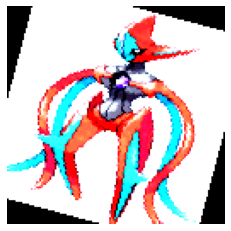

Номер элемента: 26
Истинный класс: Pidgeot
Dodrio (28.23%)
Zapdos (21.01%)
Deerling (16.56%)


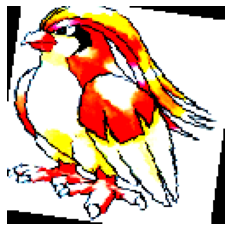

Номер элемента: 27
Истинный класс: Meowth
Raikou (35.70%)
Dragonite (14.40%)
Meowth (11.04%)


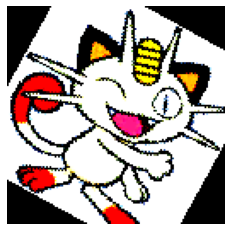

Номер элемента: 28
Истинный класс: Chansey
Chansey (75.25%)
Corsola (6.11%)
Togetic (5.83%)


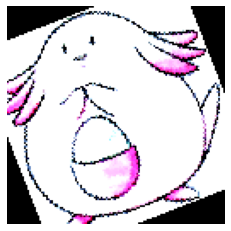

Номер элемента: 29
Истинный класс: Magikarp
Ariados (83.75%)
Baltoy (4.72%)
Magikarp (3.44%)


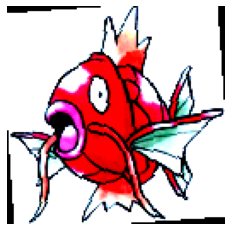

Номер элемента: 30
Истинный класс: Omanyte
Omanyte (98.75%)
Snorlax (1.12%)
Oshawott (0.11%)


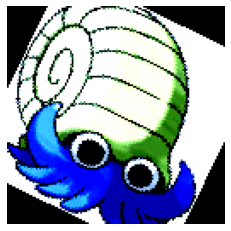

Номер элемента: 31
Истинный класс: Sawsbuck
Sawsbuck (93.33%)
Talonflame (3.31%)
Lycanroc (1.35%)


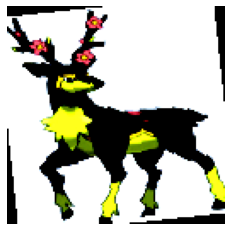

Номер элемента: 0
Истинный класс: Cacturne
Tropius (36.19%)
Vibrava (18.36%)
Torterra (14.28%)


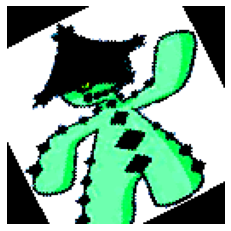

Номер элемента: 1
Истинный класс: Rockruff
Shellder (25.08%)
Spectrier (22.78%)
Meloetta (15.53%)


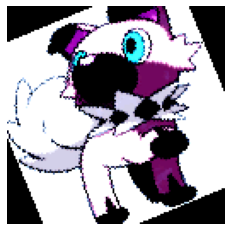

Номер элемента: 2
Истинный класс: Bulbasaur
Omastar (99.99%)
Blastoise (0.01%)
Manectric (0.00%)


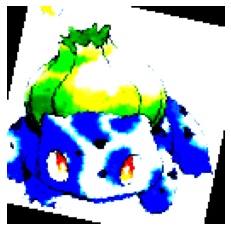

Номер элемента: 3
Истинный класс: Ledyba
Ledyba (59.99%)
Mamoswine (10.60%)
Raikou (6.93%)


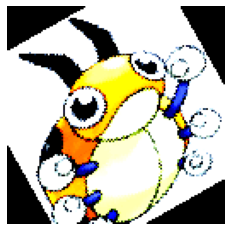

Номер элемента: 4
Истинный класс: Noibat
Noibat (73.20%)
Zoroark (13.39%)
Sneasel (3.47%)


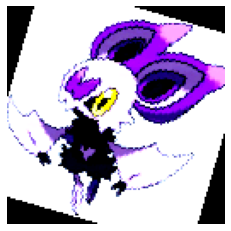

Номер элемента: 5
Истинный класс: Kabutops
Morelull (20.02%)
Meloetta (19.69%)
Arbok (15.07%)


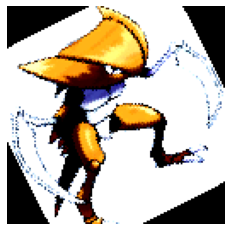

Номер элемента: 6
Истинный класс: Raikou
Raikou (83.78%)
Qwilfish (14.41%)
Charizard (0.63%)


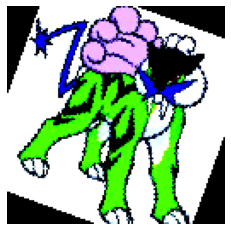

Номер элемента: 7
Истинный класс: Cyndaquil
Charizard (29.24%)
Volcanion (27.99%)
Deoxys (24.09%)


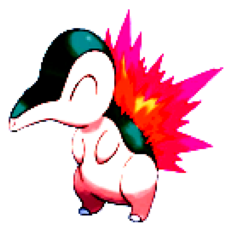

Номер элемента: 8
Истинный класс: Scizor
Scizor (92.14%)
Volcanion (7.54%)
Groudon (0.15%)


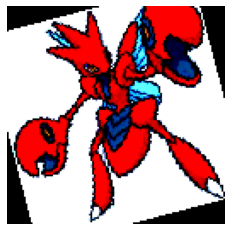

Номер элемента: 9
Истинный класс: Noivern
Cranidos (47.95%)
Tornadus (47.77%)
Riolu (1.77%)


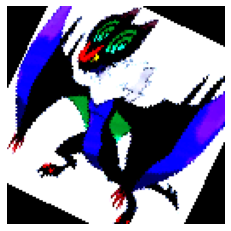

Номер элемента: 10
Истинный класс: Cacnea
Cacnea (88.73%)
Oddish (10.50%)
Graveler (0.26%)


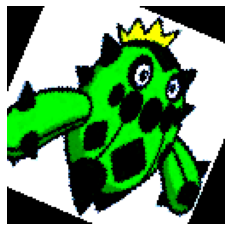

Номер элемента: 11
Истинный класс: Regieleki
Bellsprout (71.07%)
Shaymin (9.72%)
Kabutops (3.84%)


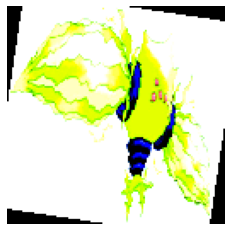

Номер элемента: 12
Истинный класс: Heracross
Bulbasaur (44.58%)
Pupitar (18.20%)
Shuppet (8.06%)


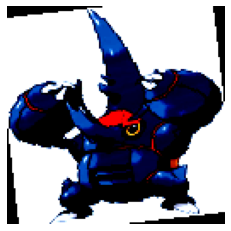

Номер элемента: 13
Истинный класс: Lanturn
Thundurus (93.90%)
Eiscue (2.15%)
Woobat (0.65%)


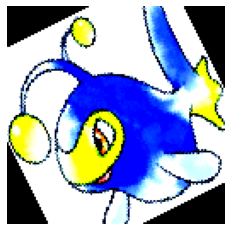

Номер элемента: 14
Истинный класс: Diancie
Silcoon (34.99%)
Corsola (25.84%)
Togetic (15.44%)


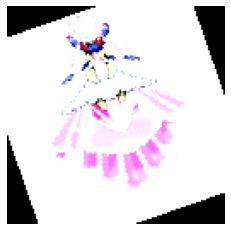

Номер элемента: 15
Истинный класс: Spearow
Raticate (38.50%)
Deerling (21.57%)
Spearow (8.68%)


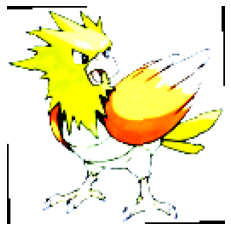

Номер элемента: 16
Истинный класс: Bidoof
Greedent (36.81%)
Crustle (16.48%)
Watchog (14.81%)


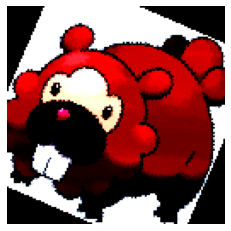

Номер элемента: 17
Истинный класс: Emolga
Reuniclus (65.93%)
Melmetal (16.83%)
Necrozma (8.16%)


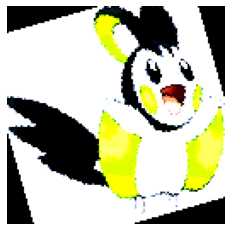

Номер элемента: 18
Истинный класс: Zigzagoon
Tauros (29.53%)
Pikachu (8.66%)
Ludicolo (6.82%)


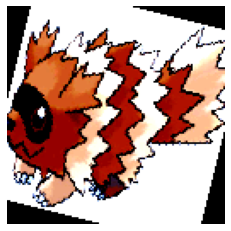

Номер элемента: 19
Истинный класс: Servine
Servine (52.66%)
Landorus (12.94%)
Kecleon (6.64%)


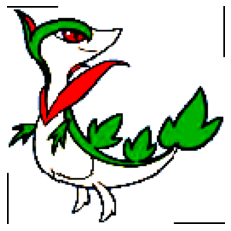

Номер элемента: 20
Истинный класс: Heracross
Vanillite (44.44%)
Chinchou (13.65%)
Toxel (9.14%)


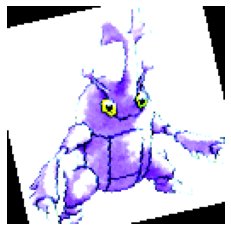

Номер элемента: 21
Истинный класс: Naganadel
Crobat (99.63%)
Tornadus (0.35%)
Hatterene (0.01%)


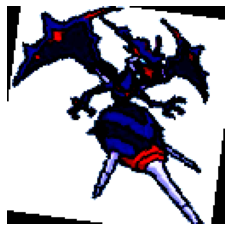

Номер элемента: 22
Истинный класс: Moltres
Groudon (92.15%)
Golem (5.71%)
Pyroar (0.82%)


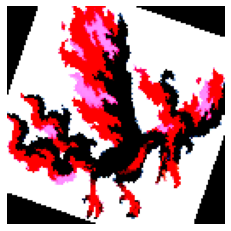

Номер элемента: 23
Истинный класс: Scorbunny
Ampharos (59.19%)
Togetic (12.26%)
Reshiram (10.80%)


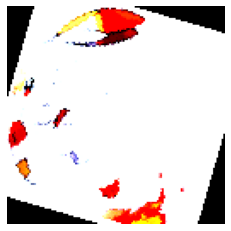

Номер элемента: 24
Истинный класс: Terrakion
Phantump (54.28%)
Mandibuzz (21.80%)
Perrserker (9.12%)


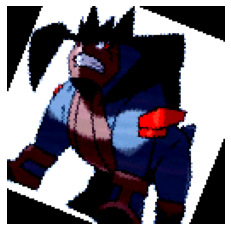

Номер элемента: 25
Истинный класс: Chimchar
Jolteon (31.81%)
Chimchar (14.17%)
Kabutops (10.01%)


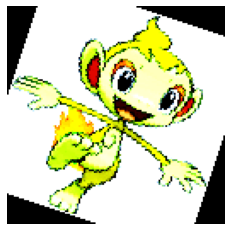

Номер элемента: 26
Истинный класс: Pincurchin
Morpeko (98.64%)
Salazzle (0.66%)
Garbodor (0.32%)


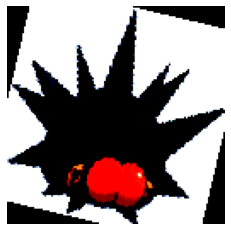

Номер элемента: 27
Истинный класс: Arcanine
Vespiquen (57.93%)
Arcanine (21.17%)
Gourgeist (4.15%)


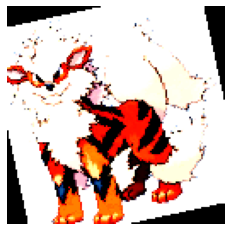

Номер элемента: 28
Истинный класс: Vaporeon
Dragonair (47.80%)
Lapras (17.61%)
Sealeo (15.77%)


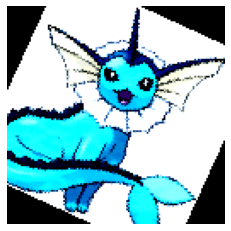

Номер элемента: 29
Истинный класс: Caterpie
Metapod (38.76%)
Larvitar (22.26%)
Victreebel (13.25%)


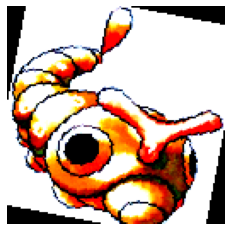

Номер элемента: 30
Истинный класс: Pinsir
Kyurem (38.14%)
Spoink (11.98%)
Silvally (11.35%)


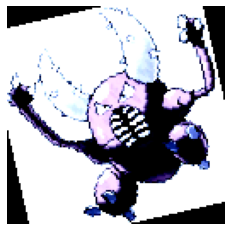

Номер элемента: 31
Истинный класс: Manectric
Huntail (40.86%)
Golbat (24.80%)
Ivysaur (4.46%)


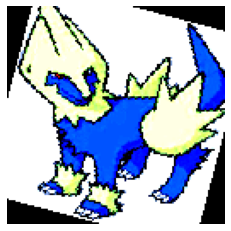

Номер элемента: 0
Истинный класс: Wartortle
Nidoran♀ (79.33%)
Litwick (14.11%)
Nidoking (3.67%)


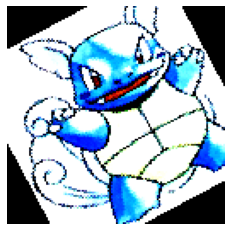

Номер элемента: 1
Истинный класс: Golduck
Greninja (64.99%)
Dialga (28.86%)
Frogadier (3.93%)


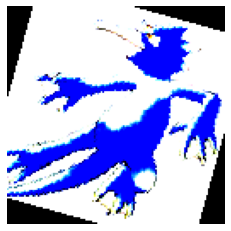

Номер элемента: 2
Истинный класс: Pichu
Pichu (74.87%)
Leafeon (17.42%)
Pidgeot (4.46%)


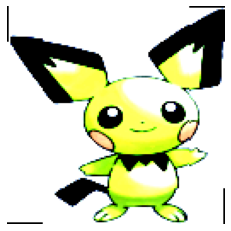

Номер элемента: 3
Истинный класс: Abra
Natu (49.01%)
Torkoal (9.24%)
Camerupt (5.91%)


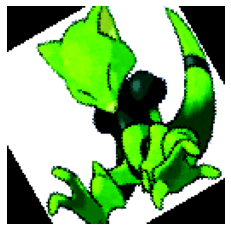

Номер элемента: 4
Истинный класс: Snorlax
Breloom (72.77%)
Tsareena (8.53%)
Kecleon (8.43%)


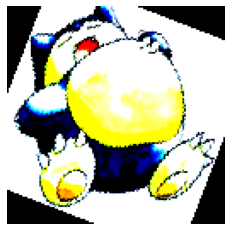

Номер элемента: 5
Истинный класс: Spoink
Machop (33.82%)
Uxie (24.74%)
Palkia (14.27%)


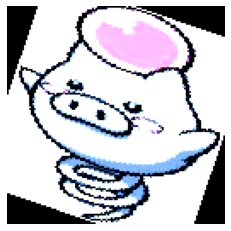

Номер элемента: 6
Истинный класс: Cubone
Marowak (89.72%)
Larvitar (5.03%)
Eiscue (2.02%)


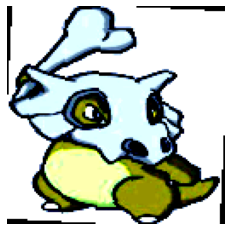

Номер элемента: 7
Истинный класс: Chesnaught
Ribombee (19.50%)
Chesnaught (19.05%)
Cacturne (16.58%)


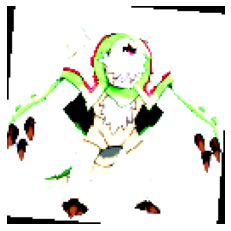

Номер элемента: 8
Истинный класс: Primeape
Solgaleo (73.12%)
Rockruff (10.97%)
Slowbro (3.73%)


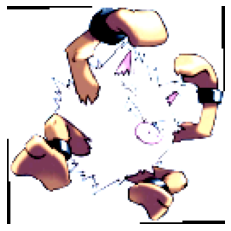

Номер элемента: 9
Истинный класс: Manectric
Togepi (81.72%)
Duraludon (10.54%)
Inteleon (3.49%)


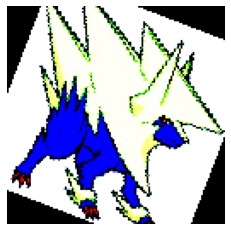

Номер элемента: 10
Истинный класс: Dugtrio
Shroomish (73.19%)
Diglett (15.39%)
Kangaskhan (3.22%)


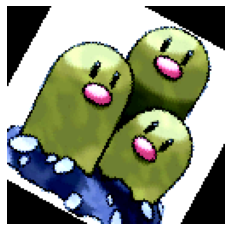

Номер элемента: 11
Истинный класс: Spritzee
Minior (27.84%)
Spritzee (15.93%)
Watchog (12.67%)


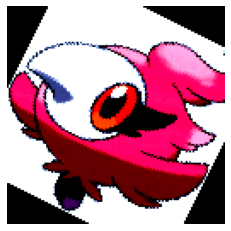

Номер элемента: 12
Истинный класс: Seedot
Basculin (49.47%)
Vibrava (41.05%)
Zygarde (5.20%)


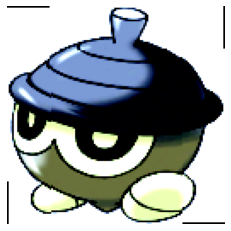

Номер элемента: 13
Истинный класс: Psyduck
Floatzel (81.99%)
Comfey (13.64%)
Aegislash (1.41%)


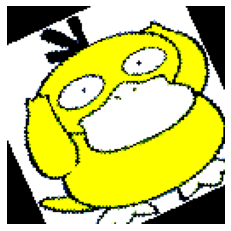

Номер элемента: 14
Истинный класс: Mudsdale
Seedot (46.72%)
Tepig (45.75%)
Shieldon (5.27%)


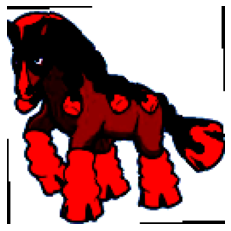

Номер элемента: 15
Истинный класс: Luxio
Gliscor (46.10%)
Shinx (25.06%)
Luxio (17.12%)


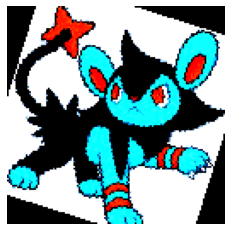

Номер элемента: 16
Истинный класс: Rampardos
Beldum (44.83%)
Rayquaza (18.47%)
Honedge (7.27%)


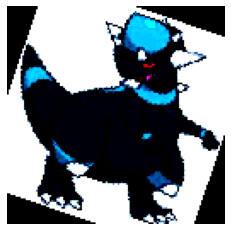

Номер элемента: 17
Истинный класс: Golem
Luxio (32.07%)
Murkrow (18.30%)
Marshadow (15.05%)


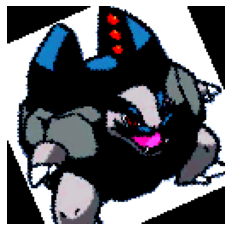

Номер элемента: 18
Истинный класс: Arbok
Grimer (45.73%)
Gastly (27.33%)
Snorlax (7.32%)


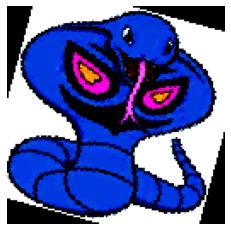

Номер элемента: 19
Истинный класс: Heracross
Dragonair (99.90%)
Sealeo (0.08%)
Celesteela (0.02%)


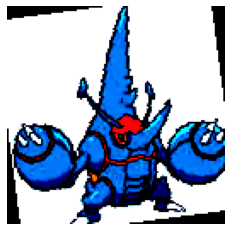

Номер элемента: 20
Истинный класс: Sudowoodo
Elekid (20.19%)
Pikachu (13.79%)
Mankey (11.29%)


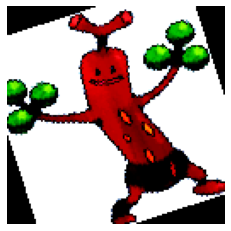

Номер элемента: 21
Истинный класс: Machamp
Zoroark (54.39%)
Skuntank (28.86%)
Braviary (7.15%)


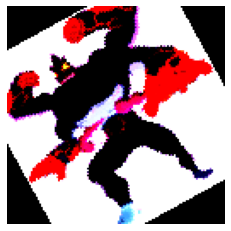

Номер элемента: 22
Истинный класс: Pikipek
Pikipek (99.04%)
Arbok (0.68%)
Dusclops (0.11%)


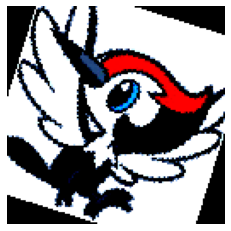

Номер элемента: 23
Истинный класс: Spinarak
Floatzel (56.88%)
Spinarak (27.11%)
Charizard (15.44%)


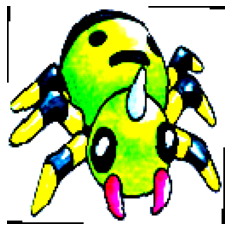

Номер элемента: 24
Истинный класс: Duosion
Solosis (98.05%)
Snorlax (0.89%)
Blastoise (0.60%)


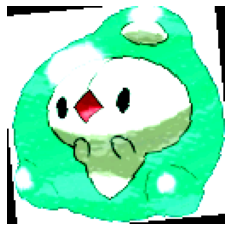

Номер элемента: 25
Истинный класс: Nuzleaf
Lycanroc (36.07%)
Beedrill (33.57%)
Meowth (8.23%)


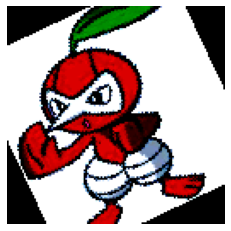

Номер элемента: 26
Истинный класс: Volcarona
Paras (52.53%)
Grubbin (11.90%)
Kabuto (10.46%)


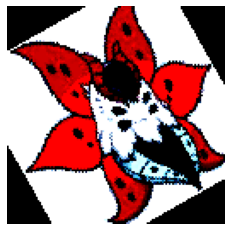

Номер элемента: 27
Истинный класс: Skorupi
Snorlax (49.71%)
Seviper (21.17%)
Ivysaur (12.22%)


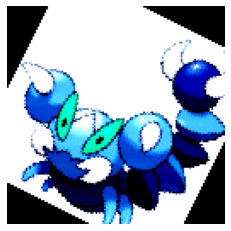

Номер элемента: 28
Истинный класс: Donphan
Steelix (51.58%)
Haunter (19.83%)
Jigglypuff (10.08%)


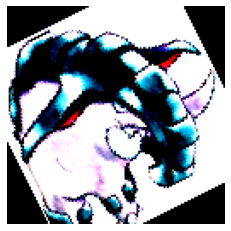

Номер элемента: 29
Истинный класс: Ursaring
Watchog (62.58%)
Greedent (12.00%)
Dugtrio (8.96%)


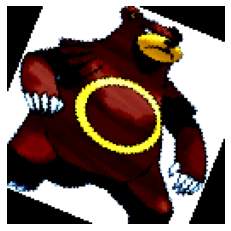

Номер элемента: 30
Истинный класс: Chingling
Pinsir (48.72%)
Entei (6.50%)
Flabébé (5.20%)


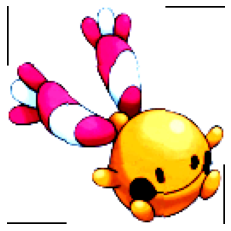

Номер элемента: 31
Истинный класс: Grimmsnarl
Poipole (29.67%)
Hattrem (22.42%)
Toxapex (14.06%)


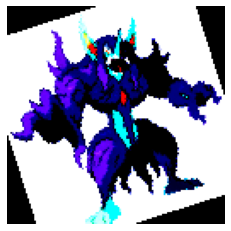

Номер элемента: 0
Истинный класс: Spinarak
Grotle (65.53%)
Vibrava (13.43%)
Spinarak (6.91%)


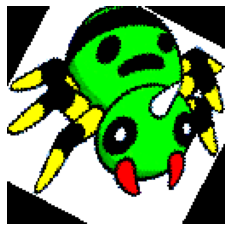

Номер элемента: 1
Истинный класс: Tyranitar
Ariados (36.83%)
Timburr (11.37%)
Shaymin (10.59%)


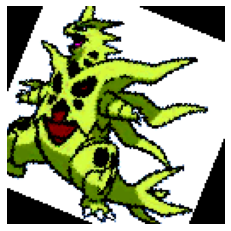

Номер элемента: 2
Истинный класс: Jumpluff
Jumpluff (97.61%)
Inkay (1.77%)
Omastar (0.28%)


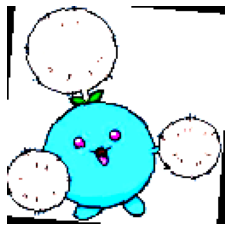

Номер элемента: 3
Истинный класс: Clefable
Clefable (26.49%)
Exeggcute (16.38%)
Swirlix (14.00%)


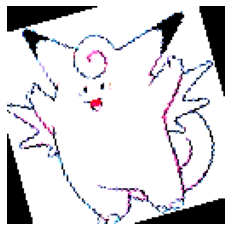

Номер элемента: 4
Истинный класс: Electabuzz
Pawniard (89.97%)
Larvesta (2.94%)
Ariados (1.20%)


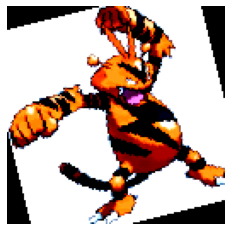

Номер элемента: 5
Истинный класс: Articuno
Mantyke (98.19%)
Articuno (0.66%)
Tropius (0.33%)


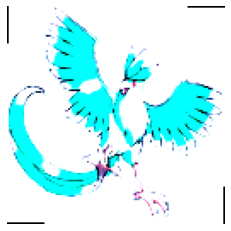

Номер элемента: 6
Истинный класс: Mismagius
Noibat (36.16%)
Genesect (24.66%)
Sableye (20.30%)


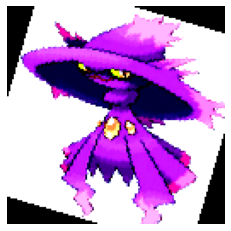

Номер элемента: 7
Истинный класс: Pidove
Minccino (70.61%)
Tynamo (11.56%)
Nincada (4.40%)


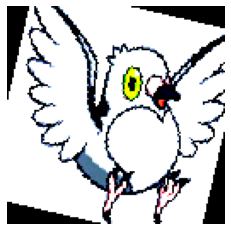

Номер элемента: 8
Истинный класс: Jigglypuff
Jigglypuff (92.19%)
Quilava (4.23%)
Ariados (1.25%)


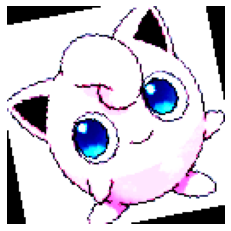

Номер элемента: 9
Истинный класс: Virizion
Virizion (90.72%)
Sawsbuck (7.05%)
Talonflame (0.52%)


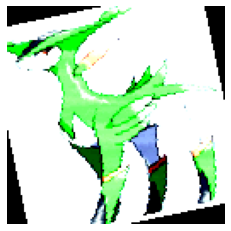

Номер элемента: 10
Истинный класс: Unown
Zebstrika (49.02%)
Gothitelle (24.90%)
Unown (9.34%)


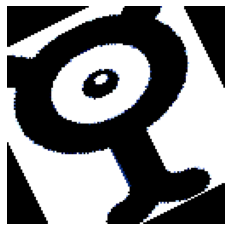

Номер элемента: 11
Истинный класс: Cramorant
Primarina (88.92%)
Metagross (8.14%)
Articuno (1.48%)


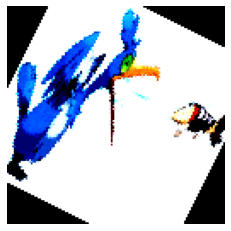

Номер элемента: 12
Истинный класс: Sinistea
Xatu (24.68%)
Urshifu (16.64%)
Sandshrew (11.26%)


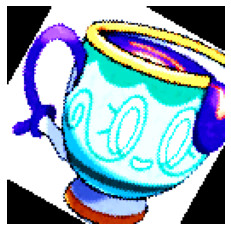

Номер элемента: 13
Истинный класс: Pumpkaboo
Pumpkaboo (94.78%)
Seedot (4.30%)
Zygarde (0.46%)


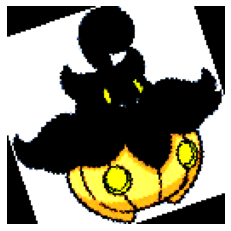

Номер элемента: 14
Истинный класс: Dewott
Seadra (90.24%)
Wooper (5.96%)
Tapu Fini (2.45%)


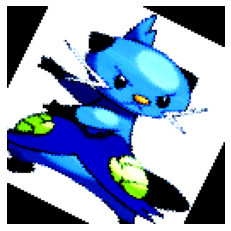

Номер элемента: 15
Истинный класс: Fletchinder
Vileplume (94.65%)
Yanma (4.06%)
Gloom (0.45%)


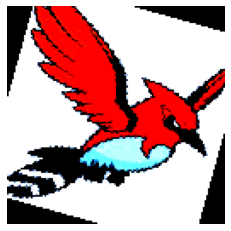

Номер элемента: 16
Истинный класс: Porygon-Z
Porygon (65.16%)
Ivysaur (21.13%)
Jellicent (10.73%)


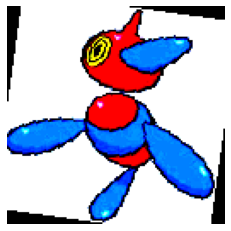

Номер элемента: 17
Истинный класс: Celebi
Butterfree (31.89%)
Shaymin (17.69%)
Flabébé (6.91%)


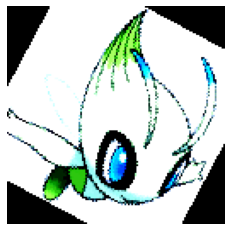

Номер элемента: 18
Истинный класс: Metang
Metang (94.14%)
Azurill (4.35%)
Tropius (1.08%)


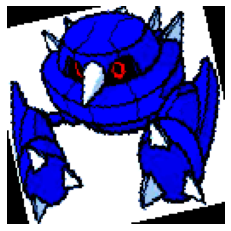

Номер элемента: 19
Истинный класс: Amaura
Amaura (86.29%)
Jumpluff (11.99%)
Dragonair (0.80%)


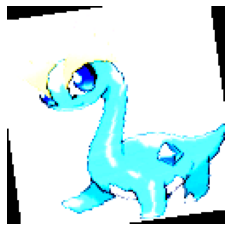

Номер элемента: 20
Истинный класс: Lugia
Latios (49.77%)
Oricorio (34.68%)
Aerodactyl (4.07%)


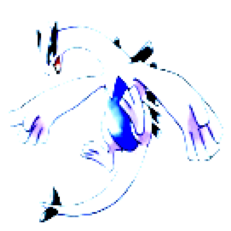

Номер элемента: 21
Истинный класс: Zacian
Zoroark (34.33%)
Basculin (28.50%)
Marshadow (20.79%)


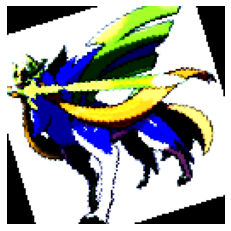

Номер элемента: 22
Истинный класс: Slakoth
Linoone (70.70%)
Golisopod (9.55%)
Beedrill (3.28%)


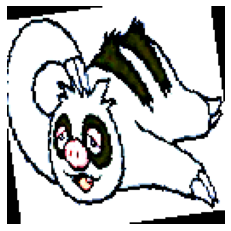

Номер элемента: 23
Истинный класс: Tangrowth
Snorlax (29.54%)
Magnezone (25.89%)
Sealeo (11.62%)


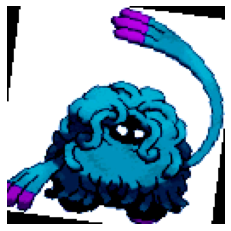

Номер элемента: 24
Истинный класс: Shroomish
Marshtomp (72.26%)
Grimer (7.88%)
Bulbasaur (5.58%)


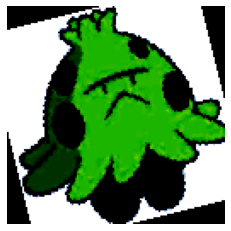

Номер элемента: 25
Истинный класс: Venusaur
Ivysaur (57.85%)
Bellossom (32.72%)
Drednaw (3.30%)


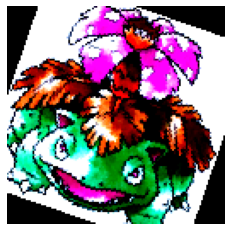

Номер элемента: 26
Истинный класс: Caterpie
Caterpie (96.26%)
Natu (0.94%)
Sawsbuck (0.56%)


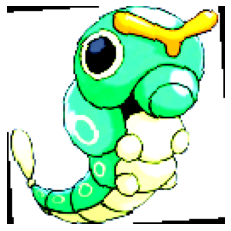

Номер элемента: 27
Истинный класс: Parasect
Buizel (34.92%)
Pikachu (13.58%)
Vespiquen (9.08%)


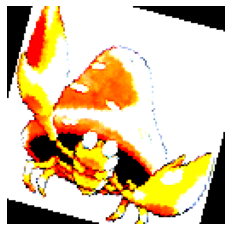

Номер элемента: 28
Истинный класс: Persian
Aerodactyl (67.33%)
Mewtwo (17.65%)
Arceus (4.40%)


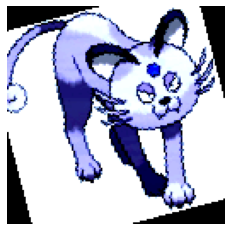

Номер элемента: 29
Истинный класс: Munchlax
Bulbasaur (74.65%)
Marshtomp (11.28%)
Swampert (7.31%)


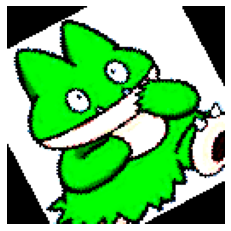

Номер элемента: 30
Истинный класс: Aerodactyl
Dratini (19.58%)
Butterfree (19.54%)
Lugia (17.21%)


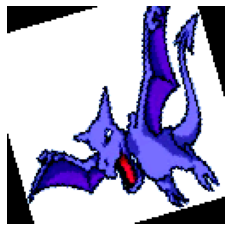

Номер элемента: 31
Истинный класс: Xatu
Eelektrik (27.96%)
Raticate (11.87%)
Chesnaught (11.82%)


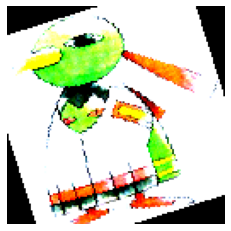

Номер элемента: 0
Истинный класс: Brionne
Beldum (73.49%)
Litten (11.34%)
Basculin (6.22%)


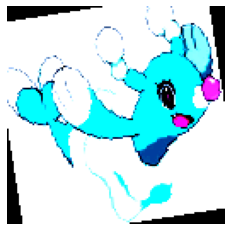

Номер элемента: 1
Истинный класс: Girafarig
Staryu (24.86%)
Pikachu (17.35%)
Ribombee (11.49%)


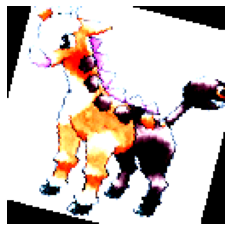

Номер элемента: 2
Истинный класс: Flaaffy
Flabébé (21.93%)
Dustox (20.63%)
Furret (8.07%)


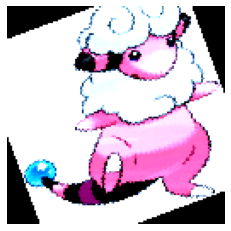

Номер элемента: 3
Истинный класс: Klinklang
Bronzong (66.76%)
Klang (32.56%)
Lumineon (0.35%)


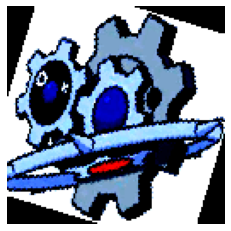

Номер элемента: 4
Истинный класс: Blitzle
Scatterbug (38.79%)
Blitzle (28.55%)
Durant (21.97%)


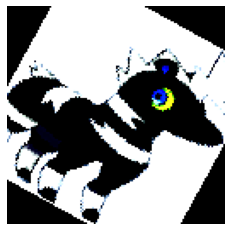

Номер элемента: 5
Истинный класс: Morelull
Morelull (95.91%)
Machoke (1.03%)
Palkia (0.96%)


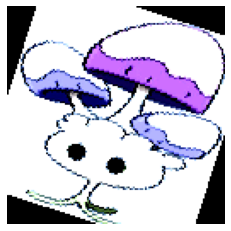

Номер элемента: 6
Истинный класс: Corphish
Blaziken (31.92%)
Pyroar (22.14%)
Electabuzz (6.51%)


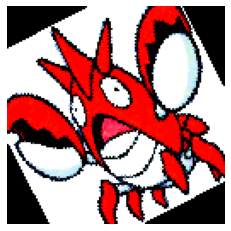

Номер элемента: 7
Истинный класс: Thwackey
Golem (60.35%)
Krookodile (21.85%)
Groudon (5.26%)


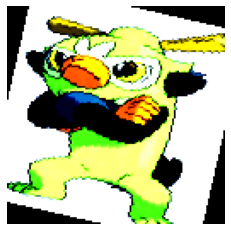

Номер элемента: 8
Истинный класс: Golem
Luxio (31.02%)
Murkrow (23.56%)
Marshadow (15.64%)


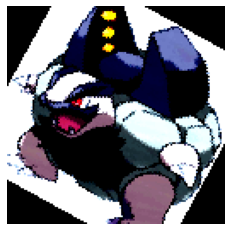

Номер элемента: 9
Истинный класс: Zamazenta
Zamazenta (65.29%)
Blastoise (29.00%)
Deoxys (4.00%)


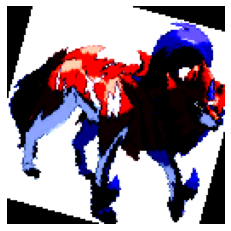

Номер элемента: 10
Истинный класс: Shiftry
Rowlet (52.60%)
Kecleon (21.96%)
Vivillon (12.49%)


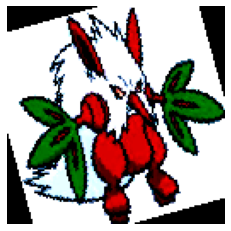

Номер элемента: 11
Истинный класс: Hoothoot
Zygarde (51.70%)
Vibrava (26.55%)
Golem (9.15%)


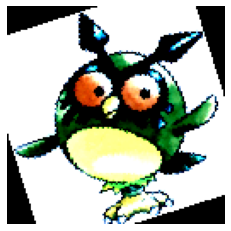

Номер элемента: 12
Истинный класс: Politoed
Camerupt (28.02%)
Simisage (14.93%)
Axew (12.88%)


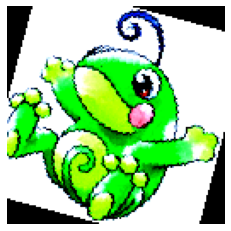

Номер элемента: 13
Истинный класс: Empoleon
Lucario (87.77%)
Basculin (8.87%)
Rowlet (2.20%)


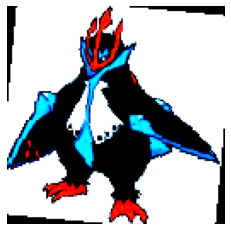

Номер элемента: 14
Истинный класс: Ditto
Frosmoth (34.61%)
Dewgong (23.87%)
Tynamo (8.33%)


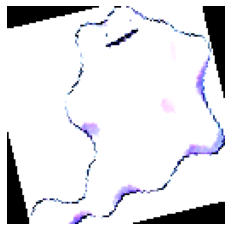

Номер элемента: 15
Истинный класс: Delphox
Scraggy (91.26%)
Lillipup (3.90%)
Victreebel (2.84%)


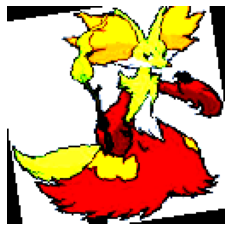

Номер элемента: 16
Истинный класс: Houndoom
Lairon (61.45%)
Kyurem (19.82%)
Houndoom (9.16%)


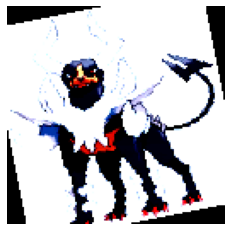

Номер элемента: 17
Истинный класс: Dragonair
Pidove (68.68%)
Sealeo (20.36%)
Furfrou (1.60%)


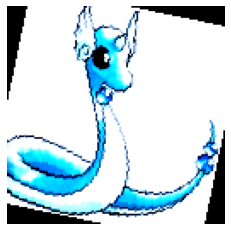

Номер элемента: 18
Истинный класс: Hawlucha
Sableye (90.22%)
Noibat (9.00%)
Exploud (0.30%)


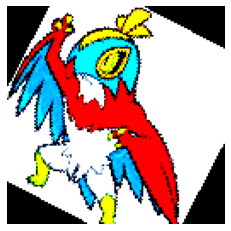

Номер элемента: 19
Истинный класс: Charizard
Kakuna (56.02%)
Parasect (19.97%)
Sewaddle (5.54%)


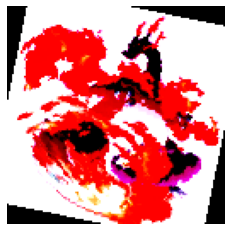

Номер элемента: 20
Истинный класс: Landorus
Litten (61.43%)
Zamazenta (21.29%)
Regigigas (4.05%)


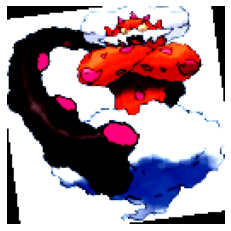

Номер элемента: 21
Истинный класс: Cufant
Mamoswine (37.25%)
Jynx (27.32%)
Cherubi (13.49%)


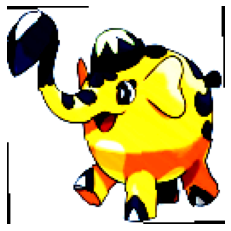

Номер элемента: 22
Истинный класс: Butterfree
Abomasnow (60.59%)
Snorlax (21.28%)
Geodude (9.61%)


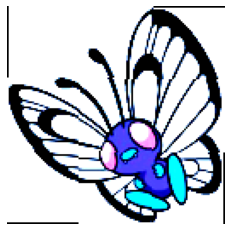

Номер элемента: 23
Истинный класс: Machop
Uxie (65.38%)
Dusclops (26.32%)
Cinccino (3.74%)


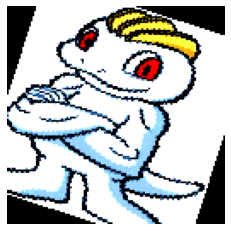

Номер элемента: 24
Истинный класс: Scorbunny
Bellsprout (64.00%)
Kabutops (19.48%)
Krabby (4.54%)


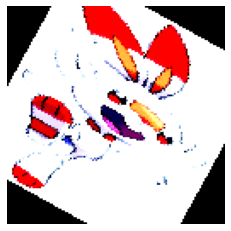

Номер элемента: 25
Истинный класс: Armaldo
Golbat (72.43%)
Ivysaur (6.27%)
Omastar (6.25%)


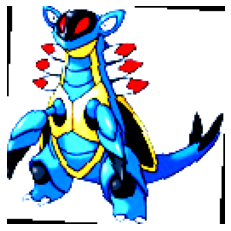

Номер элемента: 26
Истинный класс: Necrozma
Zebstrika (91.94%)
Linoone (4.01%)
Ferrothorn (1.28%)


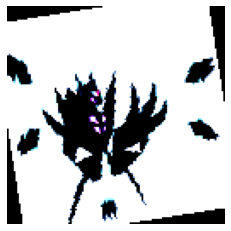

Номер элемента: 27
Истинный класс: Basculin
Oddish (63.29%)
Trubbish (6.94%)
Golem (5.79%)


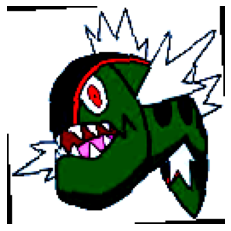

Номер элемента: 28
Истинный класс: Kricketune
Falinks (19.56%)
Krokorok (17.74%)
Bellossom (13.06%)


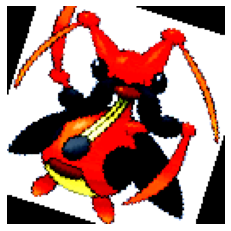

Номер элемента: 29
Истинный класс: Staryu
Persian (18.46%)
Mankey (18.12%)
Scyther (17.59%)


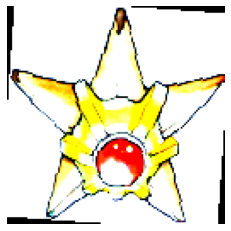

Номер элемента: 30
Истинный класс: Abra
Centiskorch (66.48%)
Slugma (11.52%)
Scraggy (5.14%)


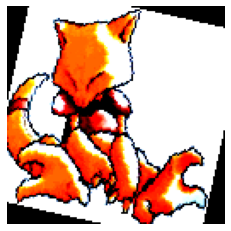

Номер элемента: 31
Истинный класс: Vaporeon
Omastar (99.97%)
Manectric (0.02%)
Mr. Rime (0.01%)


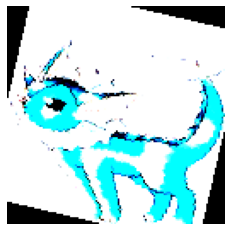

Номер элемента: 0
Истинный класс: Ninjask
Kyurem (58.35%)
Ninjask (15.95%)
Leavanny (4.89%)


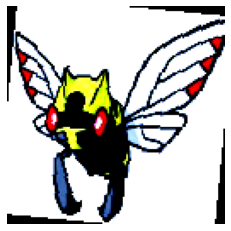

Номер элемента: 1
Истинный класс: Seismitoad
Bulbasaur (50.95%)
Metagross (21.74%)
Swampert (16.77%)


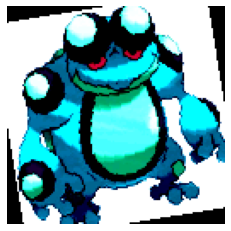

Номер элемента: 2
Истинный класс: Caterpie
Caterpie (95.06%)
Bouffalant (2.53%)
Giratina (0.64%)


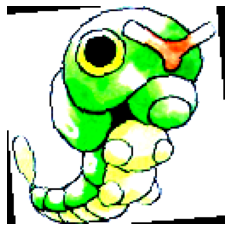

Номер элемента: 3
Истинный класс: Dunsparce
Dunsparce (83.33%)
Rockruff (2.72%)
Shaymin (2.25%)


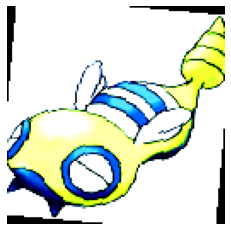

Номер элемента: 4
Истинный класс: Ampharos
Ampharos (96.99%)
Persian (1.28%)
Mankey (0.57%)


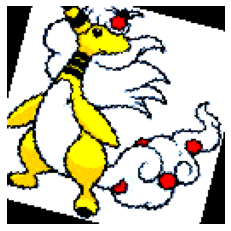

Номер элемента: 5
Истинный класс: Cherubi
Cherubi (99.98%)
Bonsly (0.02%)
Hitmontop (0.00%)


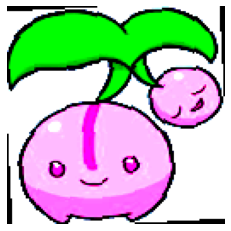

Номер элемента: 6
Истинный класс: Arbok
Gastly (41.10%)
Yamask (40.81%)
Zeraora (4.98%)


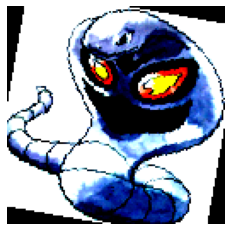

Номер элемента: 7
Истинный класс: Ho-oh
Virizion (46.38%)
Lopunny (13.16%)
Dodrio (11.87%)


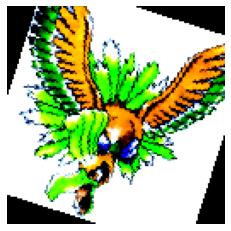

Номер элемента: 8
Истинный класс: Kadabra
Drowzee (36.64%)
Fearow (29.66%)
Moltres (11.35%)


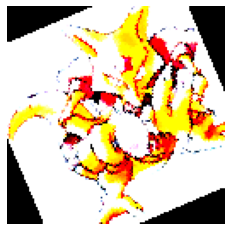

Номер элемента: 9
Истинный класс: Phione
Magnemite (42.32%)
Dialga (19.65%)
Geodude (12.04%)


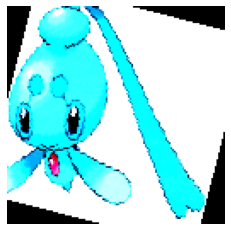

Номер элемента: 10
Истинный класс: Vanillite
Meowstic (55.73%)
Swablu (15.17%)
Frillish (7.25%)


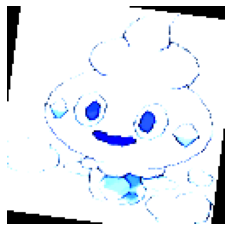

Номер элемента: 11
Истинный класс: Sandshrew
Zeraora (24.05%)
Floatzel (19.62%)
Camerupt (11.98%)


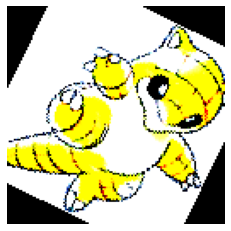

Номер элемента: 12
Истинный класс: Eternatus
Latias (63.83%)
Slowbro (21.62%)
Gabite (6.26%)


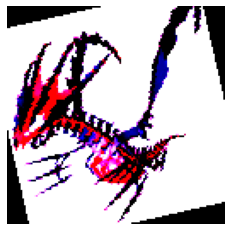

Номер элемента: 13
Истинный класс: Popplio
Manaphy (60.99%)
Sealeo (31.99%)
Lapras (5.96%)


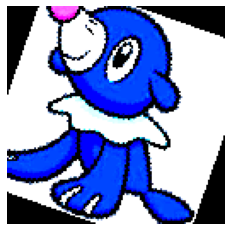

Номер элемента: 14
Истинный класс: Muk
Grimer (42.43%)
Venusaur (7.80%)
Sobble (7.55%)


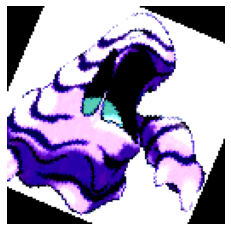

Номер элемента: 15
Истинный класс: Moltres
Boldore (26.45%)
Orbeetle (21.34%)
Garbodor (13.74%)


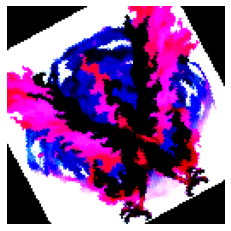

Номер элемента: 16
Истинный класс: Dhelmise
Drakloak (80.70%)
Beldum (15.64%)
Shinx (0.67%)


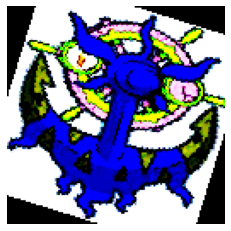

Номер элемента: 17
Истинный класс: Kakuna
Pikachu (67.77%)
Buizel (11.36%)
Growlithe (5.93%)


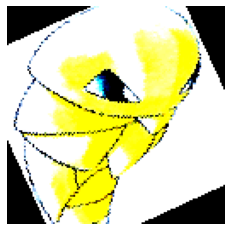

Номер элемента: 18
Истинный класс: Raichu
Elekid (27.53%)
Pidgeot (26.05%)
Kabutops (21.62%)


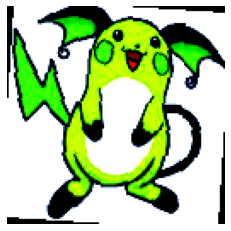

Номер элемента: 19
Истинный класс: Lycanroc
Beedrill (64.17%)
Ledyba (20.48%)
Grovyle (5.58%)


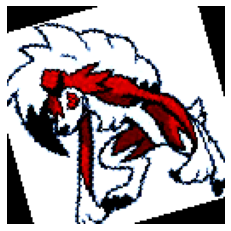

Номер элемента: 20
Истинный класс: Wormadam
Thundurus (38.98%)
Whimsicott (27.86%)
Rowlet (25.67%)


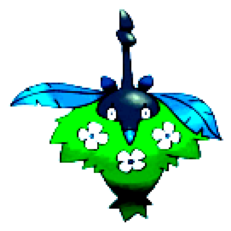

Номер элемента: 21
Истинный класс: Genesect
Genesect (98.96%)
Golduck (0.25%)
Poipole (0.12%)


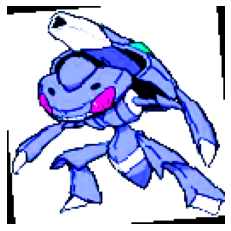

Номер элемента: 22
Истинный класс: Muk
Slowpoke (13.89%)
Zangoose (11.61%)
Corsola (11.44%)


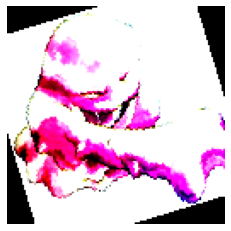

Номер элемента: 23
Истинный класс: Marowak
Persian (30.04%)
Mankey (24.30%)
Raichu (13.94%)


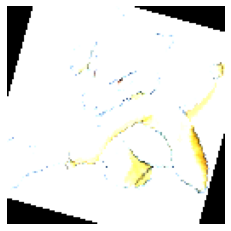

Номер элемента: 24
Истинный класс: Mareep
Pangoro (49.96%)
Poliwhirl (18.20%)
Spectrier (9.94%)


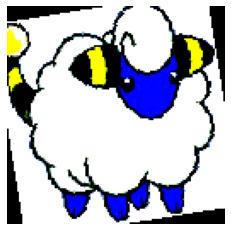

Номер элемента: 25
Истинный класс: Grumpig
Shellder (38.63%)
Rattata (11.39%)
Raticate (10.42%)


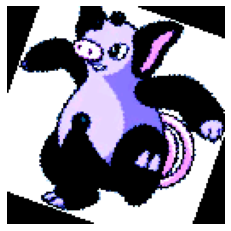

Номер элемента: 26
Истинный класс: Yungoos
Furret (33.26%)
Metapod (16.69%)
Gumshoos (9.71%)


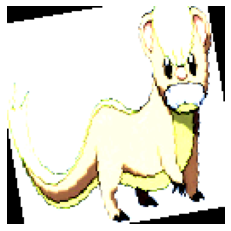

Номер элемента: 27
Истинный класс: Oricorio
Bellsprout (70.87%)
Ponyta (20.26%)
Kartana (6.80%)


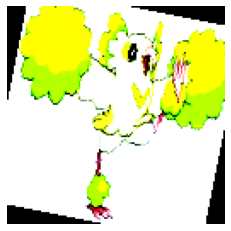

Номер элемента: 28
Истинный класс: Hariyama
Dustox (99.92%)
Bruxish (0.02%)
Muk (0.02%)


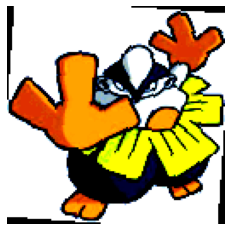

Номер элемента: 29
Истинный класс: Drowzee
Zapdos (73.37%)
Sunflora (12.61%)
Bellsprout (5.29%)


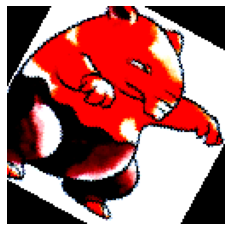

Номер элемента: 30
Истинный класс: Swellow
Eelektross (76.19%)
Hatterene (10.48%)
Skuntank (7.28%)


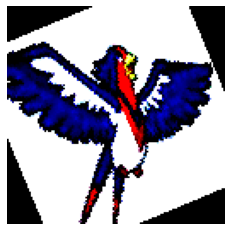

Номер элемента: 31
Истинный класс: Seel
Darmanitan (70.94%)
Furfrou (8.13%)
Ponyta (6.94%)


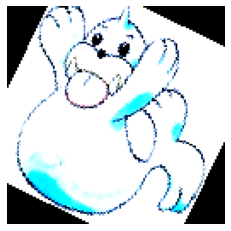

Номер элемента: 0
Истинный класс: Hoothoot
Volcanion (49.83%)
Zeraora (21.12%)
Raikou (20.09%)


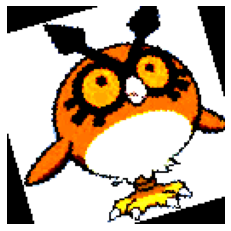

Номер элемента: 1
Истинный класс: Medicham
Medicham (72.23%)
Flabébé (12.87%)
Muk (4.31%)


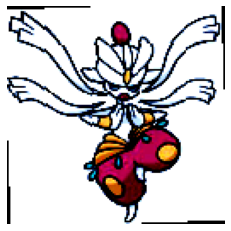

Номер элемента: 2
Истинный класс: Butterfree
Omastar (91.75%)
Inkay (3.54%)
Lapras (1.36%)


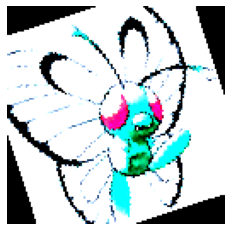

Номер элемента: 3
Истинный класс: Swampert
Swampert (62.79%)
Roserade (18.97%)
Bulbasaur (5.52%)


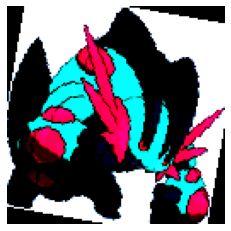

Номер элемента: 4
Истинный класс: Stunfisk
Duskull (45.44%)
Solosis (31.42%)
Mandibuzz (8.88%)


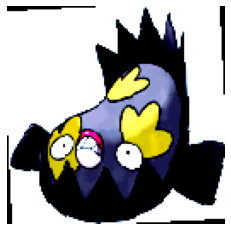

Номер элемента: 5
Истинный класс: Electrode
Electrode (86.69%)
Chimecho (6.54%)
Marowak (4.75%)


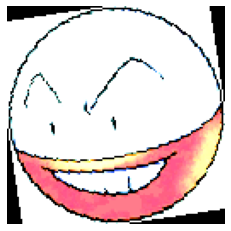

Номер элемента: 6
Истинный класс: Spearow
Alcremie (21.32%)
Doduo (21.25%)
Dodrio (9.81%)


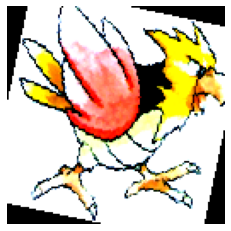

Номер элемента: 7
Истинный класс: Hariyama
Kangaskhan (20.81%)
Shroomish (18.91%)
Rockruff (16.35%)


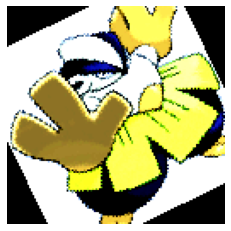

Номер элемента: 8
Истинный класс: Abomasnow
Abomasnow (51.25%)
Snom (37.34%)
Pelipper (10.63%)


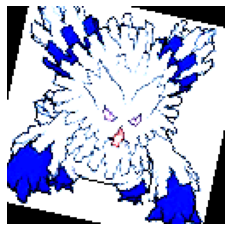

Номер элемента: 9
Истинный класс: Marowak
Marowak (70.45%)
Tyrogue (12.45%)
Cubone (3.37%)


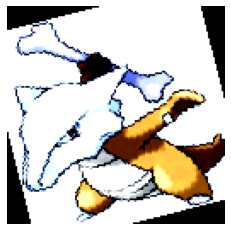

Номер элемента: 10
Истинный класс: Doduo
Victreebel (51.70%)
Farfetch'd (20.58%)
Raticate (8.90%)


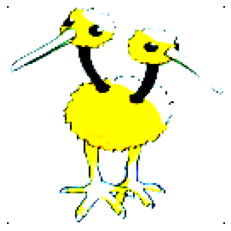

Номер элемента: 11
Истинный класс: Finneon
Ivysaur (95.64%)
Nosepass (2.10%)
Shellos (0.43%)


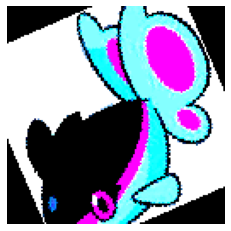

Номер элемента: 12
Истинный класс: Glalie
Swoobat (69.52%)
Xerneas (11.22%)
Lucario (9.95%)


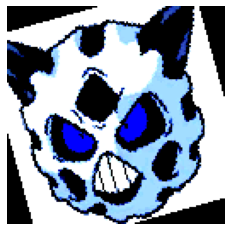

Номер элемента: 13
Истинный класс: Metapod
Metapod (70.38%)
Scyther (6.83%)
Larvitar (5.62%)


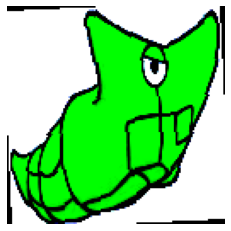

Номер элемента: 14
Истинный класс: Moltres
Pidgeotto (35.28%)
Persian (14.89%)
Fearow (10.91%)


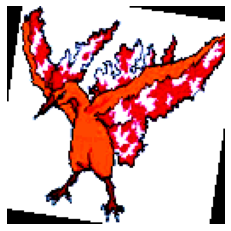

Номер элемента: 15
Истинный класс: Throh
Throh (43.78%)
Tapu Bulu (12.76%)
Pikipek (12.69%)


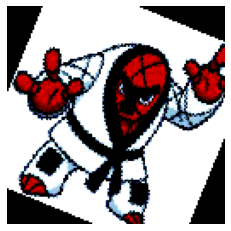

Номер элемента: 16
Истинный класс: Slowpoke
Aromatisse (13.85%)
Abra (13.85%)
Paras (10.02%)


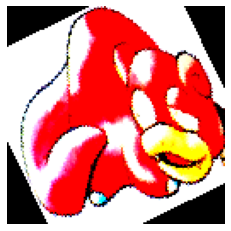

Номер элемента: 17
Истинный класс: Toxtricity
Exploud (20.89%)
Wooper (14.60%)
Beldum (13.64%)


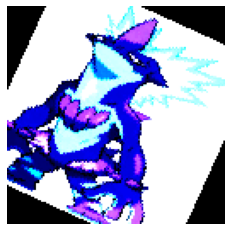

Номер элемента: 18
Истинный класс: Solgaleo
Zigzagoon (91.26%)
Shroomish (5.54%)
Relicanth (1.54%)


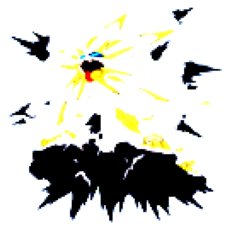

Номер элемента: 19
Истинный класс: Weavile
Zoroark (34.37%)
Morgrem (30.82%)
Poipole (22.27%)


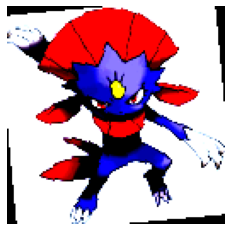

Номер элемента: 20
Истинный класс: Raticate
Raticate (80.26%)
Rattata (10.36%)
Skwovet (6.18%)


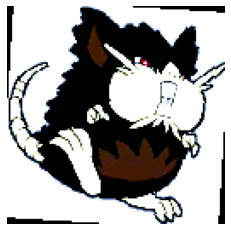

Номер элемента: 21
Истинный класс: Magcargo
Magcargo (89.09%)
Eelektrik (3.72%)
Floatzel (3.46%)


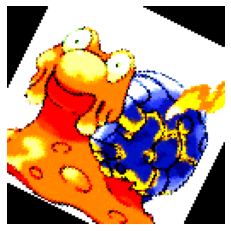

Номер элемента: 22
Истинный класс: Toxicroak
Heracross (51.20%)
Regice (24.27%)
Brionne (7.87%)


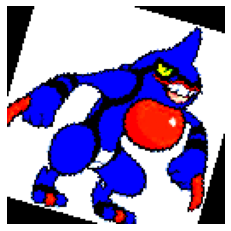

Номер элемента: 23
Истинный класс: Yamper
Hippopotas (20.06%)
Abra (19.34%)
Victreebel (13.98%)


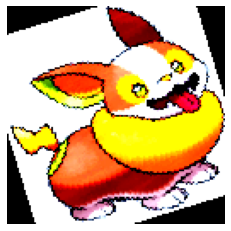

Номер элемента: 24
Истинный класс: Donphan
Pineco (65.10%)
Drakloak (14.87%)
Croagunk (5.62%)


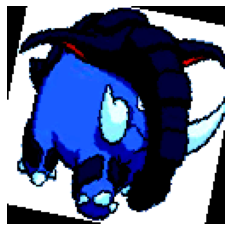

Номер элемента: 25
Истинный класс: Flabébé
Flabébé (69.40%)
Meganium (15.13%)
Shaymin (13.85%)


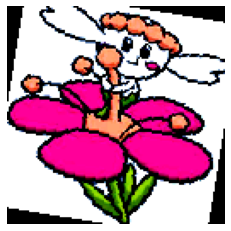

Номер элемента: 26
Истинный класс: Applin
Meganium (87.66%)
Metapod (8.15%)
Slowking (1.53%)


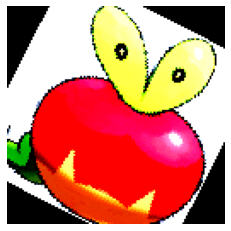

Номер элемента: 27
Истинный класс: Slowbro
Corsola (30.09%)
Cleffa (29.01%)
Slowpoke (21.17%)


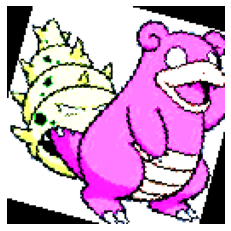

Номер элемента: 28
Истинный класс: Bronzong
Rayquaza (74.20%)
Tropius (6.07%)
Poliwag (5.38%)


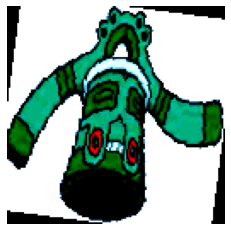

Номер элемента: 29
Истинный класс: Gulpin
Sirfetch'd (72.73%)
Gulpin (19.82%)
Furfrou (1.83%)


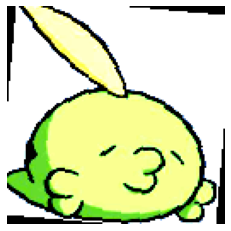

Номер элемента: 30
Истинный класс: Unown
Drampa (60.58%)
Magnemite (23.23%)
Ferrothorn (3.91%)


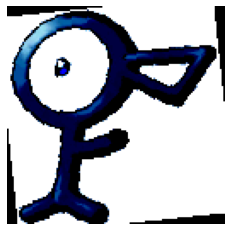

Номер элемента: 31
Истинный класс: Cutiefly
Alcremie (36.50%)
Latias (11.40%)
Steenee (10.66%)


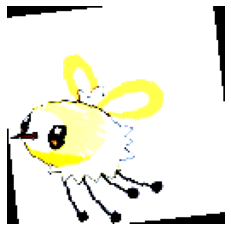

Номер элемента: 0
Истинный класс: Miltank
Nidoking (25.27%)
Articuno (24.28%)
Hatterene (16.15%)


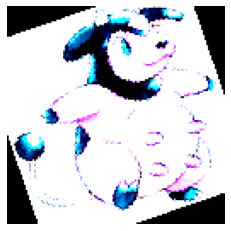

Номер элемента: 1
Истинный класс: Ho-oh
Nickit (49.73%)
Gumshoos (16.26%)
Watchog (14.96%)


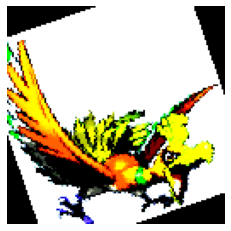

Номер элемента: 2
Истинный класс: Onix
Honedge (71.28%)
Tympole (13.50%)
Snorlax (12.63%)


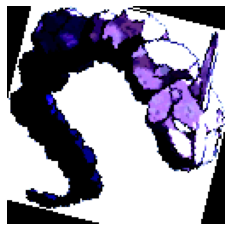

Номер элемента: 3
Истинный класс: Pumpkaboo
Pumpkaboo (95.83%)
Tepig (3.98%)
Camerupt (0.13%)


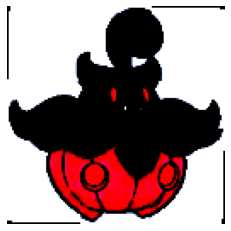

Номер элемента: 4
Истинный класс: Kangaskhan
Eelektrik (80.12%)
Nidoking (9.94%)
Ledian (2.42%)


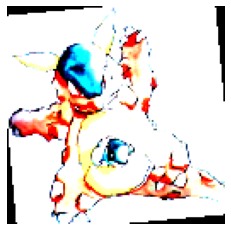

Номер элемента: 5
Истинный класс: Raticate
Raticate (67.54%)
Torchic (4.22%)
Staryu (4.21%)


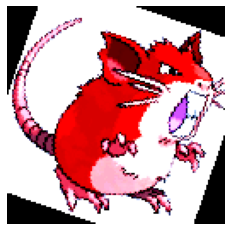

Номер элемента: 6
Истинный класс: Bewear
Darkrai (91.11%)
Bewear (3.49%)
Staraptor (1.26%)


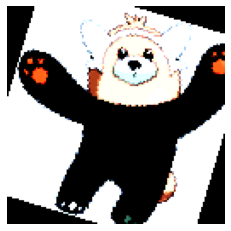

Номер элемента: 7
Истинный класс: Shellder
Tropius (53.43%)
Wailmer (13.77%)
Fomantis (10.89%)


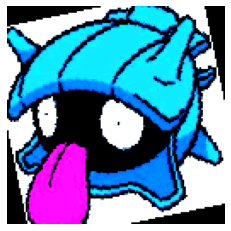

Номер элемента: 8
Истинный класс: Murkrow
Lucario (45.62%)
Shellder (14.39%)
Murkrow (9.45%)


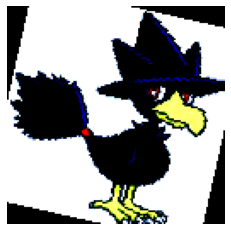

Номер элемента: 9
Истинный класс: Bastiodon
Rolycoly (87.92%)
Zygarde (9.80%)
Mawile (1.72%)


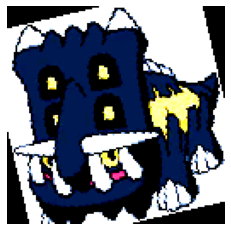

Номер элемента: 10
Истинный класс: Deerling
Deerling (43.68%)
Kabutops (26.94%)
Zapdos (17.72%)


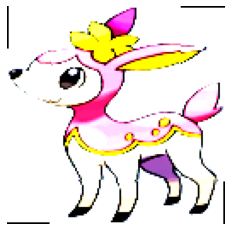

Номер элемента: 11
Истинный класс: Pansage
Pansage (52.80%)
Simisage (28.96%)
Blastoise (12.09%)


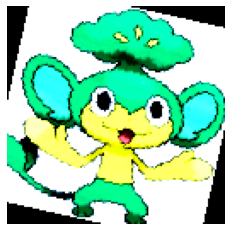

Номер элемента: 12
Истинный класс: Mewtwo
Silvally (66.64%)
Rhydon (9.21%)
Tynamo (5.70%)


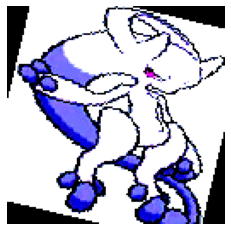

Номер элемента: 13
Истинный класс: Registeel
Chandelure (77.56%)
Rayquaza (9.52%)
Aggron (4.49%)


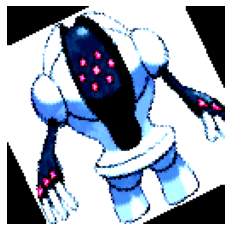

Номер элемента: 14
Истинный класс: Tentacruel
Tentacruel (99.91%)
Greninja (0.05%)
Illumise (0.04%)


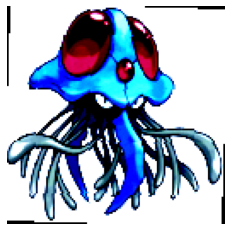

Номер элемента: 15
Истинный класс: Regirock
Urshifu (57.44%)
Machoke (6.20%)
Stunky (5.36%)


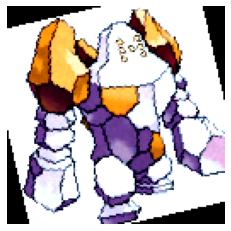

Номер элемента: 16
Истинный класс: Golurk
Froakie (22.17%)
Cranidos (17.99%)
Wailmer (15.71%)


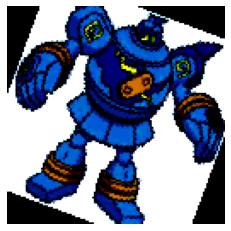

Номер элемента: 17
Истинный класс: Hoopa
Urshifu (33.12%)
Hoopa (16.97%)
Palkia (10.63%)


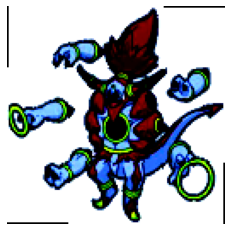

Номер элемента: 18
Истинный класс: Kyogre
Latios (72.82%)
Skuntank (18.49%)
Mismagius (2.52%)


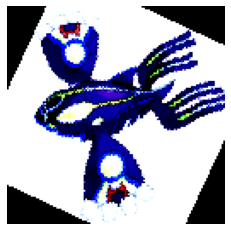

Номер элемента: 19
Истинный класс: Glameow
Arbok (34.83%)
Spectrier (21.09%)
Poliwhirl (14.80%)


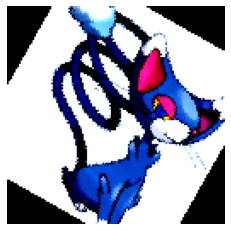

Номер элемента: 20
Истинный класс: Altaria
Poliwhirl (94.79%)
Marowak (3.78%)
Mr. Mime (1.04%)


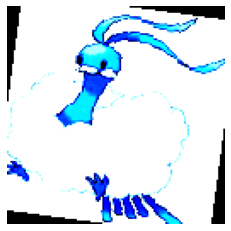

Номер элемента: 21
Истинный класс: Oranguru
Archeops (84.86%)
Minun (13.42%)
Dracovish (0.98%)


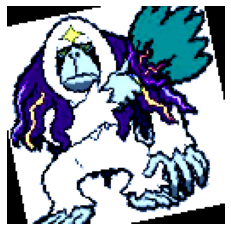

Номер элемента: 22
Истинный класс: Foongus
Bunnelby (97.24%)
Gurdurr (0.91%)
Dragalge (0.62%)


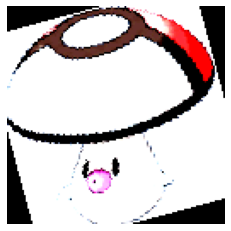

Номер элемента: 23
Истинный класс: Kirlia
Lombre (34.82%)
Grovyle (19.00%)
Carnivine (18.82%)


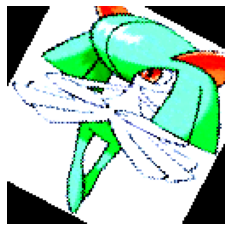

Номер элемента: 24
Истинный класс: Arceus
Arceus (86.54%)
Lycanroc (7.12%)
Beedrill (5.55%)


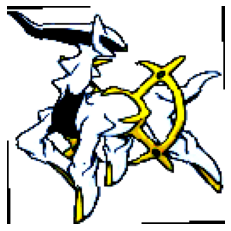

Номер элемента: 25
Истинный класс: Grovyle
Geodude (74.22%)
Cottonee (13.73%)
Sceptile (4.70%)


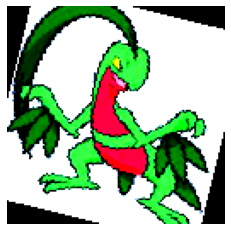

Номер элемента: 26
Истинный класс: Ponyta
Ponyta (51.37%)
Yanma (33.51%)
Krabby (8.14%)


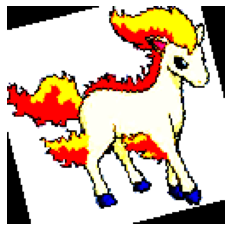

Номер элемента: 27
Истинный класс: Duosion
Solosis (100.00%)
Melmetal (0.00%)
Snorlax (0.00%)


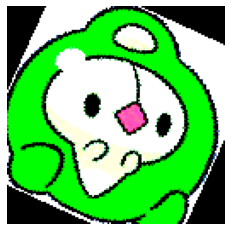

Номер элемента: 28
Истинный класс: Charmander
Pidgeot (65.72%)
Alakazam (14.55%)
Weedle (6.78%)


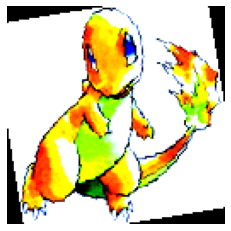

Номер элемента: 29
Истинный класс: Zweilous
Zweilous (89.36%)
Pangoro (7.11%)
Bastiodon (2.27%)


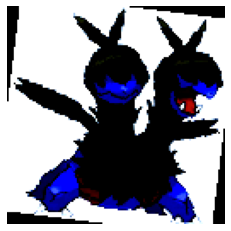

Номер элемента: 30
Истинный класс: Porygon
Aurorus (67.01%)
Omastar (18.10%)
Lapras (4.49%)


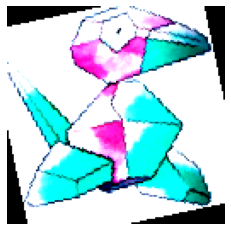

Номер элемента: 31
Истинный класс: Mawile
Giratina (53.97%)
Necrozma (15.28%)
Vibrava (10.68%)


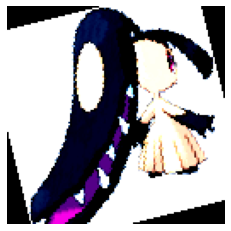

Номер элемента: 0
Истинный класс: Drapion
Haunter (75.47%)
Palkia (6.40%)
Oranguru (5.38%)


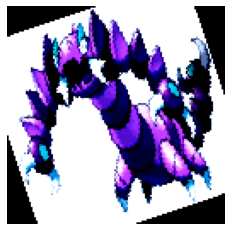

Номер элемента: 1
Истинный класс: Muk
Seadra (33.78%)
Beldum (13.85%)
Wooper (10.43%)


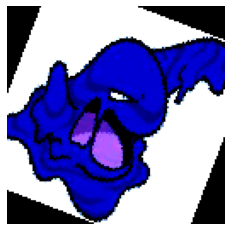

Номер элемента: 2
Истинный класс: Sneasel
Greninja (97.10%)
Poipole (0.84%)
Gloom (0.54%)


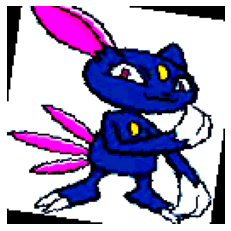

Номер элемента: 3
Истинный класс: Centiskorch
Lunatone (31.67%)
Furfrou (16.61%)
Vivillon (14.32%)


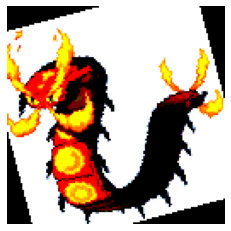

Номер элемента: 4
Истинный класс: Manectric
Vileplume (91.69%)
Oddish (6.98%)
Gloom (1.05%)


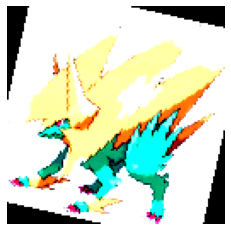

Номер элемента: 5
Истинный класс: Pinsir
Mimikyu (35.28%)
Sirfetch'd (11.81%)
Cutiefly (7.70%)


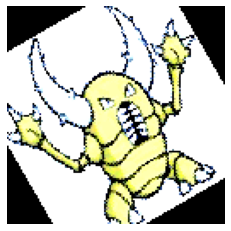

Номер элемента: 6
Истинный класс: Farfetch'd
Oricorio (34.12%)
Latias (21.80%)
Doduo (18.19%)


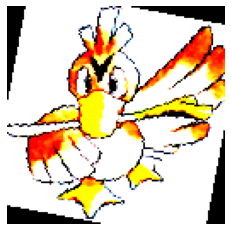

Номер элемента: 7
Истинный класс: Eternatus
Tornadus (99.98%)
Giratina (0.00%)
Honchkrow (0.00%)


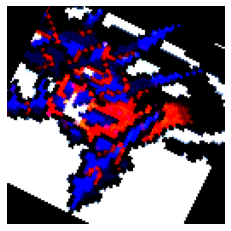

Номер элемента: 8
Истинный класс: Obstagoon
Aerodactyl (39.41%)
Unfezant (18.69%)
Haunter (8.39%)


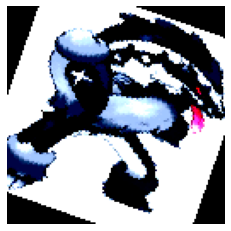

Номер элемента: 9
Истинный класс: Amoonguss
Slowbro (67.62%)
Magnemite (12.86%)
Blastoise (11.42%)


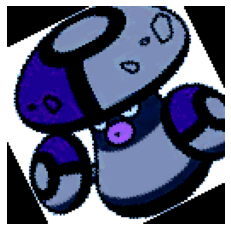

Номер элемента: 10
Истинный класс: Sudowoodo
Sudowoodo (69.15%)
Leafeon (30.36%)
Pichu (0.32%)


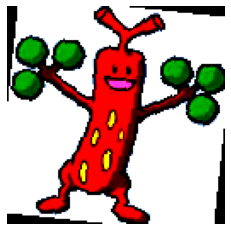

Номер элемента: 11
Истинный класс: Froakie
Shinx (42.83%)
Croagunk (14.62%)
Beldum (14.61%)


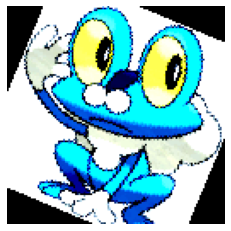

Номер элемента: 12
Истинный класс: Electrike
Grimer (66.68%)
Nidoqueen (20.53%)
Metagross (6.17%)


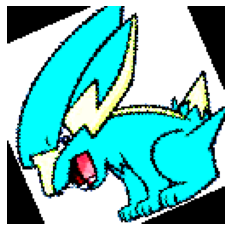

Номер элемента: 13
Истинный класс: Mienfoo
Pidgeotto (26.50%)
Blaziken (10.08%)
Lickitung (7.21%)


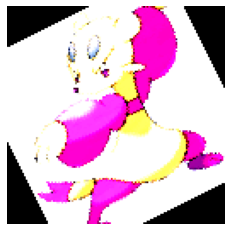

Номер элемента: 14
Истинный класс: Corvisquire
Swoobat (53.93%)
Corviknight (36.40%)
Lumineon (2.91%)


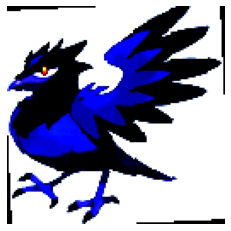

Номер элемента: 15
Истинный класс: Luxray
Graveler (76.27%)
Rayquaza (8.51%)
Zygarde (4.48%)


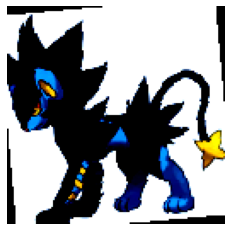

Номер элемента: 16
Истинный класс: Milotic
Volcanion (63.78%)
Charizard (30.38%)
Milotic (3.57%)


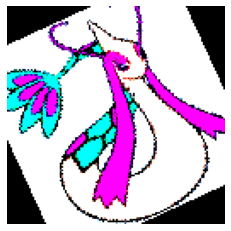

Номер элемента: 17
Истинный класс: Xerneas
Xerneas (70.10%)
Celebi (15.00%)
Arceus (7.28%)


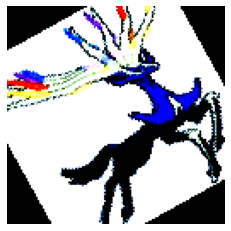

Номер элемента: 18
Истинный класс: Voltorb
Fennekin (68.07%)
Parasect (12.21%)
Fearow (7.76%)


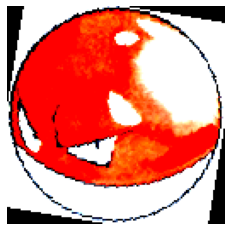

Номер элемента: 19
Истинный класс: Regirock
Escavalier (84.34%)
Dragalge (14.76%)
Krabby (0.36%)


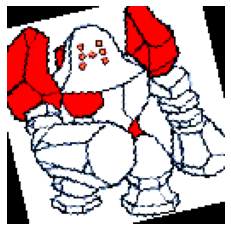

Номер элемента: 20
Истинный класс: Zacian
Decidueye (76.86%)
Garbodor (16.81%)
Quilava (3.82%)


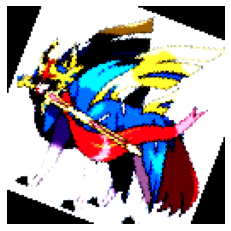

Номер элемента: 21
Истинный класс: Cursola
Pheromosa (68.82%)
Frosmoth (6.28%)
Gardevoir (5.20%)


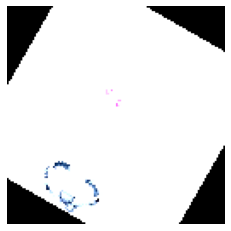

Номер элемента: 22
Истинный класс: Yungoos
Furret (25.19%)
Gumshoos (18.17%)
Eldegoss (11.52%)


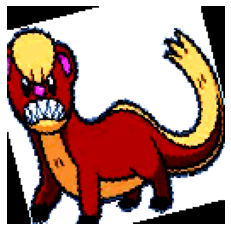

Номер элемента: 23
Истинный класс: Frillish
Mewtwo (86.86%)
Aipom (2.87%)
Genesect (2.23%)


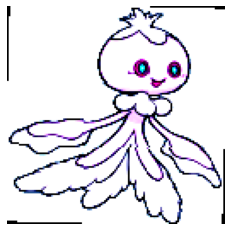

Номер элемента: 24
Истинный класс: Hypno
Alakazam (36.72%)
Numel (18.87%)
Scyther (14.62%)


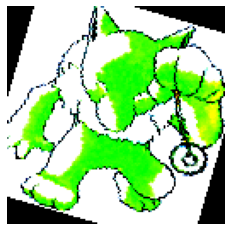

Номер элемента: 25
Истинный класс: Poliwrath
Snorlax (38.74%)
Crabominable (29.06%)
Rayquaza (20.07%)


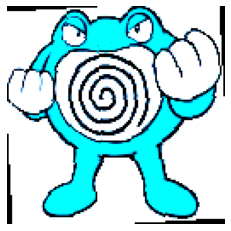

Номер элемента: 26
Истинный класс: Palossand
Minior (30.77%)
Ludicolo (29.16%)
Hippopotas (17.46%)


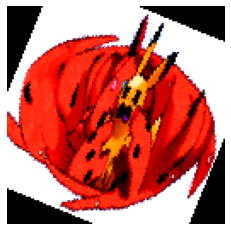

Номер элемента: 27
Истинный класс: Sandile
Tapu Lele (88.24%)
Beheeyem (3.61%)
Torkoal (1.81%)


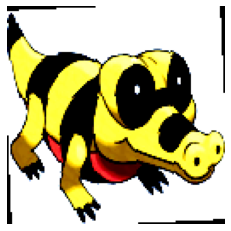

Номер элемента: 28
Истинный класс: Seaking
Sandslash (67.88%)
Kingler (10.79%)
Minior (8.69%)


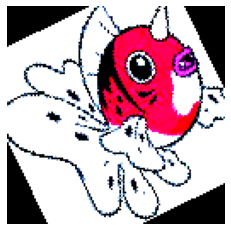

Номер элемента: 29
Истинный класс: Magearna
Granbull (17.79%)
Skrelp (13.29%)
Tranquill (9.08%)


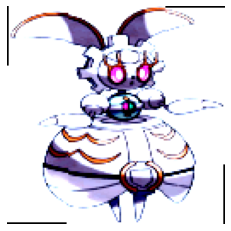

Номер элемента: 30
Истинный класс: Lunatone
Torkoal (18.23%)
Gastly (10.61%)
Xatu (10.17%)


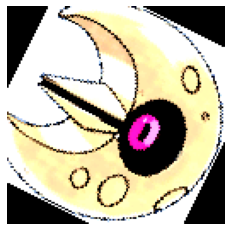

Номер элемента: 31
Истинный класс: Archen
Snom (50.30%)
Jirachi (24.72%)
Froslass (9.12%)


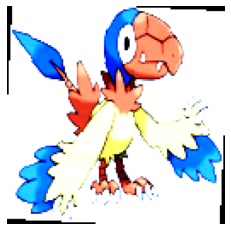

Номер элемента: 0
Истинный класс: Bounsweet
Tornadus (57.44%)
Dwebble (12.18%)
Litten (7.43%)


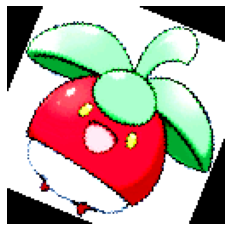

Номер элемента: 1
Истинный класс: Seaking
Shelmet (84.75%)
Whimsicott (5.57%)
Ariados (3.90%)


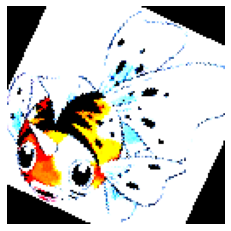

Номер элемента: 2
Истинный класс: Trevenant
Trevenant (99.98%)
Vibrava (0.01%)
Mawile (0.00%)


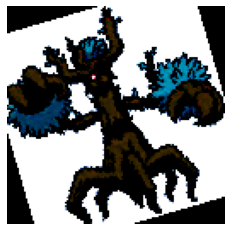

Номер элемента: 3
Истинный класс: Vivillon
Urshifu (61.89%)
Rattata (34.80%)
Weezing (2.08%)


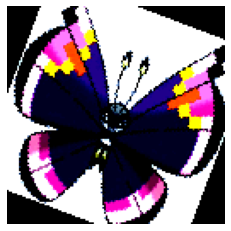

Номер элемента: 4
Истинный класс: Cascoon
Mewtwo (82.81%)
Silcoon (4.21%)
Togepi (3.45%)


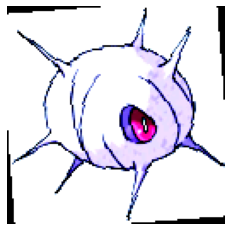

Номер элемента: 5
Истинный класс: Mankey
Exeggcute (27.54%)
Persian (19.59%)
Ninetales (11.00%)


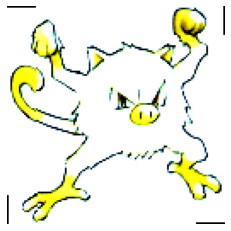

Номер элемента: 6
Истинный класс: Cryogonal
Donphan (75.53%)
Carracosta (6.10%)
Grimer (4.11%)


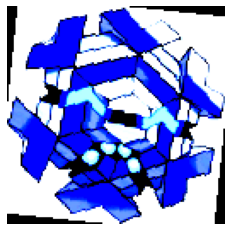

Номер элемента: 7
Истинный класс: Lopunny
Sawsbuck (26.48%)
Steenee (20.93%)
Kommo-o (9.11%)


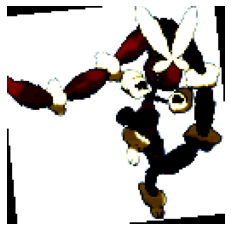

Номер элемента: 8
Истинный класс: Aipom
Toxtricity (26.94%)
Diancie (17.56%)
Exeggcute (14.70%)


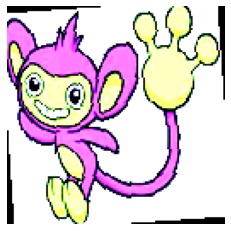

Номер элемента: 9
Истинный класс: Castform
Latios (33.10%)
Weezing (17.15%)
Nidorino (13.45%)


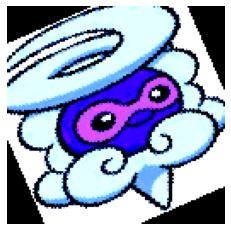

Номер элемента: 10
Истинный класс: Raichu
Pidgeot (57.16%)
Raichu (18.55%)
Alakazam (7.06%)


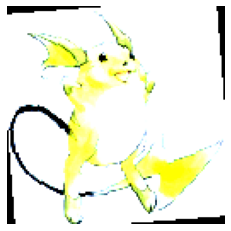

Номер элемента: 11
Истинный класс: Clauncher
Jumpluff (82.78%)
Magnezone (13.18%)
Samurott (2.87%)


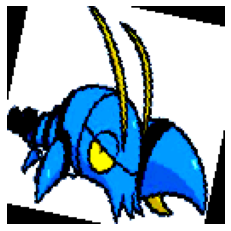

Номер элемента: 12
Истинный класс: Minior
Minior (98.80%)
Alakazam (0.98%)
Joltik (0.07%)


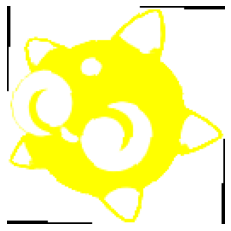

Номер элемента: 13
Истинный класс: Sigilyph
Braviary (69.67%)
Phantump (7.90%)
Sigilyph (7.37%)


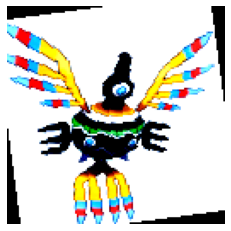

Номер элемента: 14
Истинный класс: Finneon
Slowbro (63.37%)
Urshifu (5.21%)
Rowlet (3.92%)


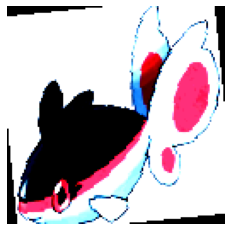

Номер элемента: 15
Истинный класс: Infernape
Rapidash (69.52%)
Voltorb (11.36%)
Typhlosion (10.50%)


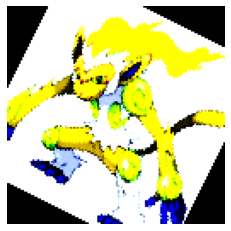

Номер элемента: 16
Истинный класс: Blastoise
Dragonair (42.01%)
Blastoise (15.34%)
Nidoqueen (10.80%)


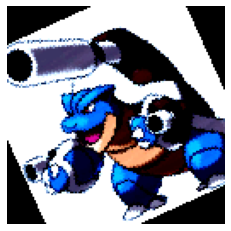

Номер элемента: 17
Истинный класс: Qwilfish
Qwilfish (88.55%)
Eelektross (1.69%)
Bonsly (1.51%)


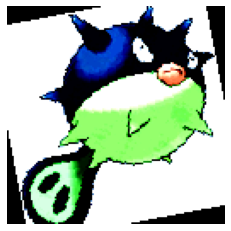

Номер элемента: 18
Истинный класс: Zigzagoon
Zygarde (63.01%)
Heatran (15.60%)
Sandaconda (11.31%)


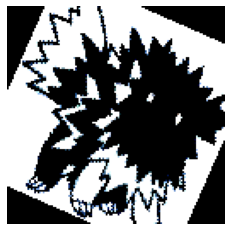

Номер элемента: 19
Истинный класс: Munchlax
Wynaut (17.30%)
Wartortle (15.02%)
Grimer (13.72%)


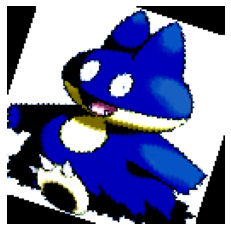

Номер элемента: 20
Истинный класс: Larvitar
Larvitar (79.58%)
Swadloon (14.36%)
Swinub (1.94%)


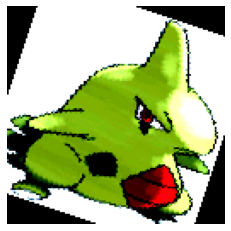

Номер элемента: 21
Истинный класс: Smoochum
Smoochum (98.45%)
Rotom (0.58%)
Paras (0.29%)


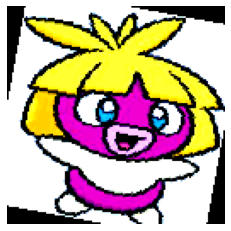

Номер элемента: 22
Истинный класс: Rhyperior
Rhyperior (69.75%)
Litten (24.33%)
Spiritomb (3.16%)


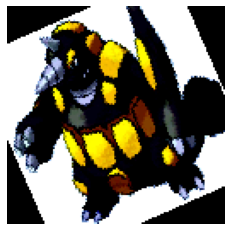

Номер элемента: 23
Истинный класс: Dragonite
Pinsir (21.32%)
Ampharos (16.28%)
Wurmple (16.27%)


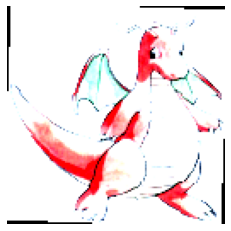

Номер элемента: 24
Истинный класс: Piplup
Piplup (34.95%)
Lucario (20.22%)
Cranidos (16.09%)


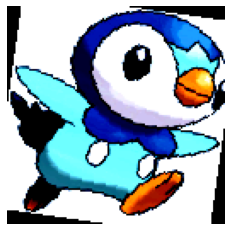

Номер элемента: 25
Истинный класс: Sandygast
Sandygast (61.25%)
Beedrill (11.38%)
Blaziken (9.39%)


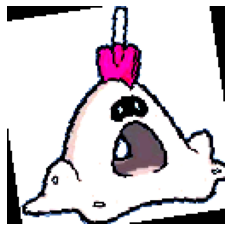

Номер элемента: 26
Истинный класс: Roggenrola
Morpeko (39.77%)
Muk (14.47%)
Thundurus (10.69%)


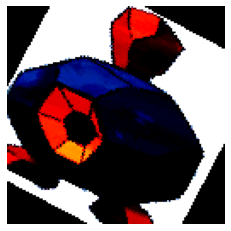

Номер элемента: 27
Истинный класс: Stoutland
Snorlax (78.75%)
Kecleon (4.50%)
Duskull (4.38%)


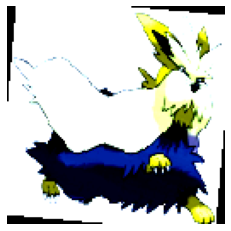

Номер элемента: 28
Истинный класс: Mudkip
Mudkip (99.96%)
Gible (0.04%)
Seadra (0.01%)


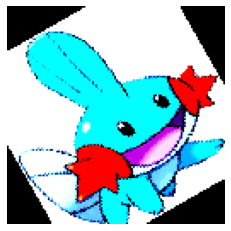

Номер элемента: 29
Истинный класс: Foongus
Kirlia (67.60%)
Runerigus (5.65%)
Unfezant (5.50%)


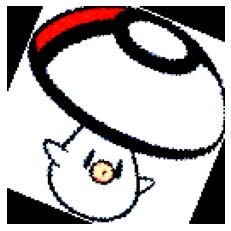

Номер элемента: 30
Истинный класс: Kadabra
Pikachu (18.72%)
Alakazam (15.02%)
Pidgeot (10.25%)


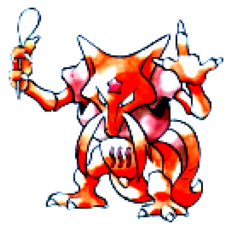

Номер элемента: 31
Истинный класс: Dewgong
Happiny (26.04%)
Sliggoo (21.18%)
Furfrou (9.00%)


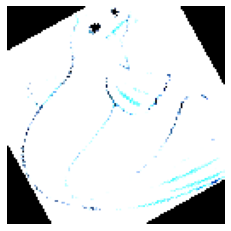

Номер элемента: 0
Истинный класс: Hitmonchan
Hitmonchan (32.83%)
Oricorio (27.39%)
Dodrio (10.33%)


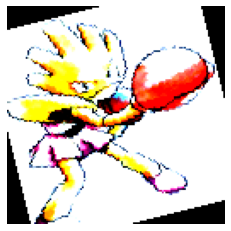

Номер элемента: 1
Истинный класс: Elekid
Lopunny (22.53%)
Electabuzz (20.11%)
Chespin (17.13%)


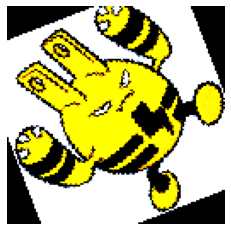

Номер элемента: 2
Истинный класс: Magcargo
Magcargo (95.66%)
Boldore (1.02%)
Gengar (0.96%)


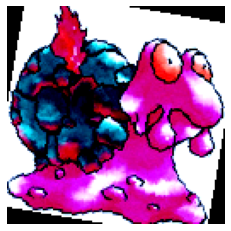

Номер элемента: 3
Истинный класс: Flygon
Kirlia (23.25%)
Beedrill (22.61%)
Cradily (15.79%)


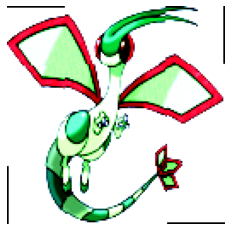

Номер элемента: 4
Истинный класс: Whirlipede
Whirlipede (99.77%)
Morpeko (0.12%)
Grimer (0.08%)


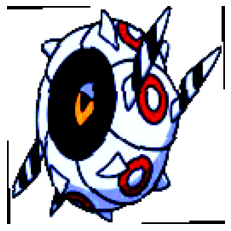

Номер элемента: 5
Истинный класс: Budew
Swadloon (84.16%)
Larvitar (7.54%)
Dustox (5.12%)


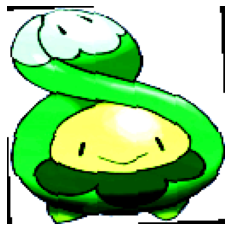

Номер элемента: 6
Истинный класс: Tangrowth
Cramorant (99.61%)
Whiscash (0.20%)
Clauncher (0.08%)


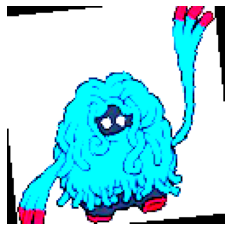

Номер элемента: 7
Истинный класс: Latias
Latias (84.21%)
Slowpoke (6.68%)
Oricorio (2.51%)


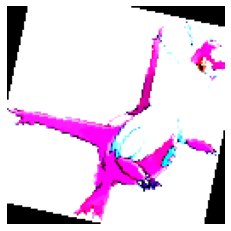

Номер элемента: 8
Истинный класс: Diancie
Dusclops (46.74%)
Cinccino (27.66%)
Shroomish (5.65%)


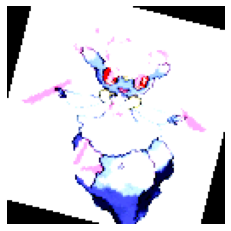

Номер элемента: 9
Истинный класс: Smeargle
Minccino (96.61%)
Tynamo (1.29%)
Arceus (0.50%)


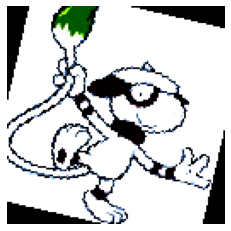

Номер элемента: 10
Истинный класс: Nidorino
Nidoran♂ (77.72%)
Nidoking (9.92%)
Nidoran♀ (3.47%)


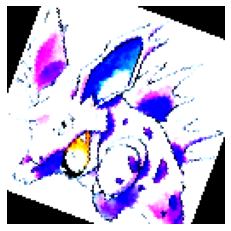

Номер элемента: 11
Истинный класс: Mightyena
Graveler (35.02%)
Rayquaza (23.70%)
Necrozma (12.40%)


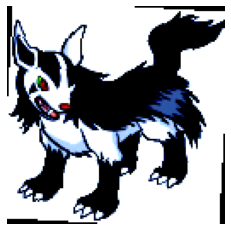

Номер элемента: 12
Истинный класс: Sandshrew
Ninetales (44.21%)
Blaziken (18.59%)
Charmander (10.31%)


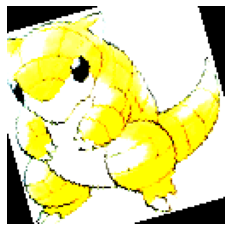

Номер элемента: 13
Истинный класс: Pidgey
Farfetch'd (45.96%)
Pidgey (36.57%)
Alakazam (9.26%)


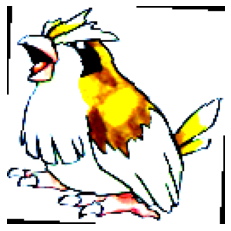

Номер элемента: 14
Истинный класс: Ambipom
Skarmory (41.18%)
Swellow (31.21%)
Taillow (7.67%)


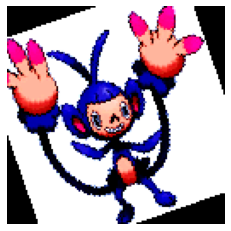

Номер элемента: 15
Истинный класс: Tentacool
Cubchoo (44.15%)
Wailord (43.17%)
Zubat (5.47%)


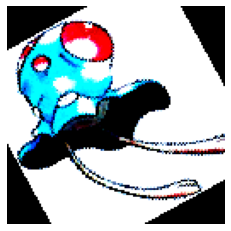

Номер элемента: 16
Истинный класс: Shinx
Shinx (27.24%)
Litten (19.98%)
Marshadow (19.19%)


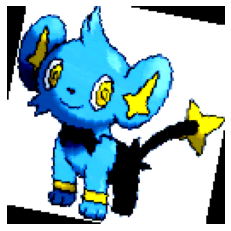

Номер элемента: 17
Истинный класс: Maractus
Bellossom (40.74%)
Zoroark (27.38%)
Kabuto (20.73%)


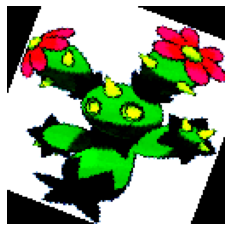

Номер элемента: 18
Истинный класс: Weezing
Tangela (31.14%)
Kyogre (23.94%)
Steelix (13.01%)


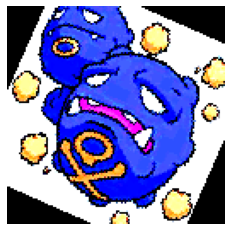

Номер элемента: 19
Истинный класс: Phanpy
Toxapex (42.42%)
Sableye (21.53%)
Mareanie (11.75%)


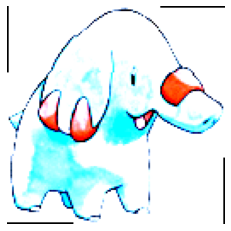

Номер элемента: 20
Истинный класс: Pidgey
Yamper (26.12%)
Pidgey (25.87%)
Staryu (5.59%)


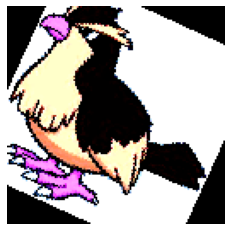

Номер элемента: 21
Истинный класс: Sobble
Oddish (45.74%)
Samurott (21.08%)
Greninja (10.34%)


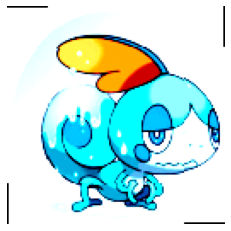

Номер элемента: 22
Истинный класс: Kubfu
Poochyena (51.19%)
Kyurem (9.53%)
Type Null (8.97%)


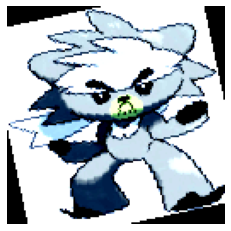

Номер элемента: 23
Истинный класс: Kingler
Shellos (56.31%)
Kingler (25.64%)
Krabby (7.35%)


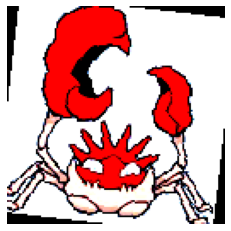

Номер элемента: 24
Истинный класс: Vaporeon
Jumpluff (58.73%)
Omastar (17.29%)
Swablu (11.17%)


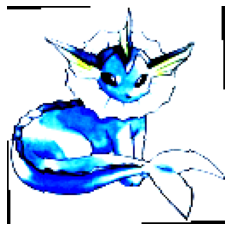

Номер элемента: 25
Истинный класс: Sandshrew
Rhydon (31.00%)
Delibird (24.07%)
Geodude (12.88%)


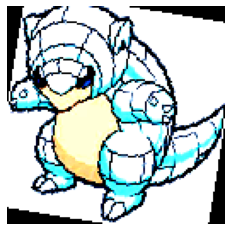

Номер элемента: 26
Истинный класс: Skiploom
Bellsprout (49.97%)
Lopunny (24.58%)
Kabuto (14.11%)


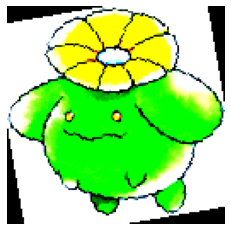

Номер элемента: 27
Истинный класс: Goldeen
Goldeen (80.24%)
Beedrill (8.01%)
Raichu (2.53%)


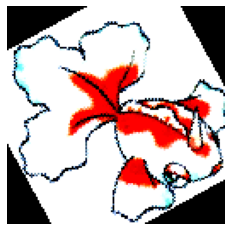

Номер элемента: 28
Истинный класс: Arcanine
Ribombee (27.56%)
Girafarig (9.75%)
Electabuzz (9.04%)


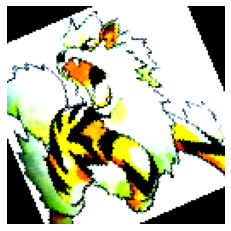

Номер элемента: 29
Истинный класс: Diglett
Diglett (99.65%)
Dugtrio (0.25%)
Piloswine (0.03%)


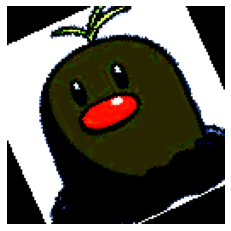

Номер элемента: 30
Истинный класс: Voltorb
Parasect (92.75%)
Voltorb (4.57%)
Paras (0.92%)


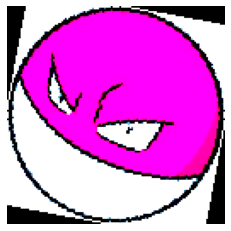

Номер элемента: 31
Истинный класс: Dhelmise
Garchomp (31.51%)
Snivy (16.10%)
Croagunk (12.25%)


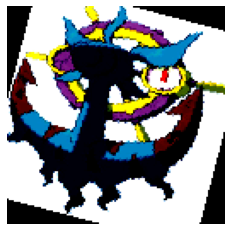

Номер элемента: 0
Истинный класс: Meowth
Metagross (49.39%)
Kangaskhan (9.30%)
Typhlosion (8.92%)


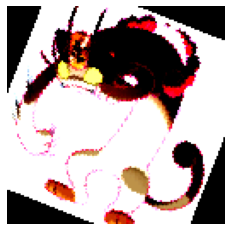

Номер элемента: 1
Истинный класс: Roserade
Zacian (27.57%)
Gogoat (24.82%)
Skiddo (23.26%)


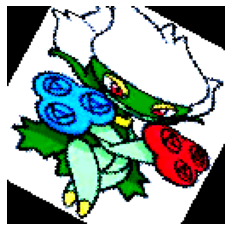

Номер элемента: 2
Истинный класс: Absol
Mr. Mime (75.79%)
Persian (18.78%)
Snom (2.41%)


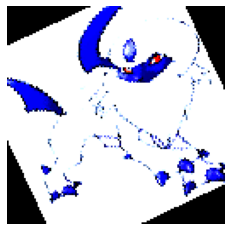

Номер элемента: 3
Истинный класс: Shuckle
Scraggy (71.54%)
Hoppip (16.01%)
Shuckle (5.14%)


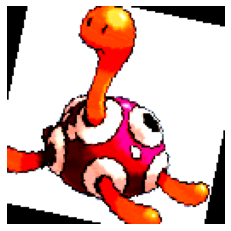

Номер элемента: 4
Истинный класс: Musharna
Slowbro (31.60%)
Comfey (24.99%)
Lickitung (14.01%)


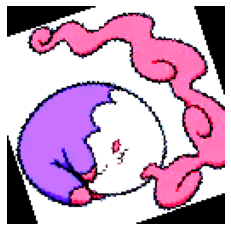

Номер элемента: 5
Истинный класс: Rotom
Greninja (56.69%)
Latios (19.77%)
Skarmory (10.11%)


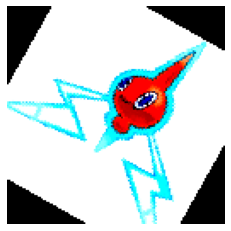

Номер элемента: 6
Истинный класс: Muk
Muk (77.44%)
Beldum (15.63%)
Chinchou (4.36%)


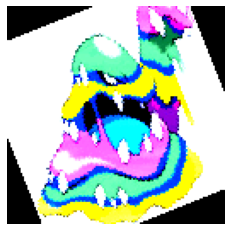

Номер элемента: 7
Истинный класс: Cinderace
Slowking (72.33%)
Pinsir (14.37%)
Hoppip (7.76%)


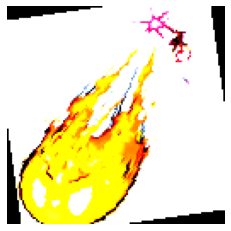

Номер элемента: 8
Истинный класс: Darmanitan
Honedge (37.36%)
Rayquaza (16.90%)
Zygarde (10.65%)


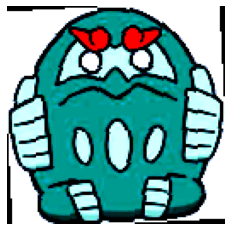

Номер элемента: 9
Истинный класс: Entei
Rhyperior (31.66%)
Blastoise (16.90%)
Budew (10.18%)


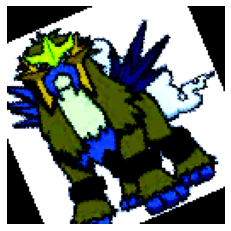

Номер элемента: 10
Истинный класс: Bayleef
Ninetales (11.24%)
Slowking (10.20%)
Scraggy (9.86%)


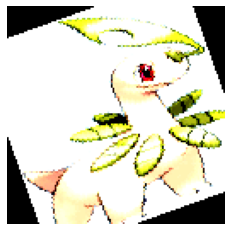

Номер элемента: 11
Истинный класс: Kakuna
Kakuna (92.43%)
Abra (1.45%)
Bidoof (0.99%)


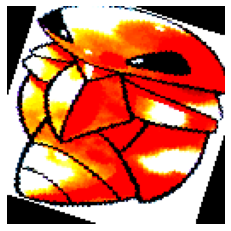

Номер элемента: 12
Истинный класс: Dusknoir
Relicanth (75.40%)
Mandibuzz (14.68%)
Stufful (2.96%)


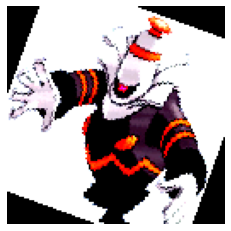

Номер элемента: 13
Истинный класс: Serperior
Magnemite (61.09%)
Geodude (16.72%)
Rayquaza (6.20%)


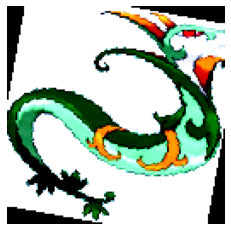

Номер элемента: 14
Истинный класс: Diancie
Tyrogue (52.36%)
Gorebyss (8.71%)
Medicham (7.54%)


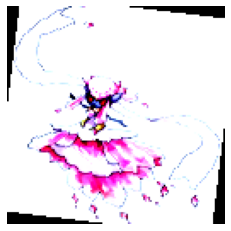

Номер элемента: 15
Истинный класс: Gengar
Silvally (43.34%)
Rhydon (13.95%)
Unown (9.10%)


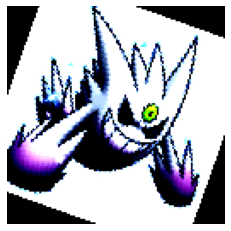

Номер элемента: 16
Истинный класс: Necrozma
Raichu (61.60%)
Alakazam (23.37%)
Pidgeot (2.75%)


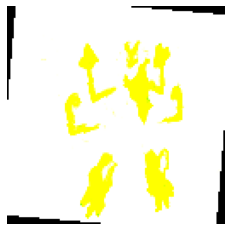

Номер элемента: 17
Истинный класс: Marshadow
Gliscor (51.85%)
Grimer (8.04%)
Tornadus (6.36%)


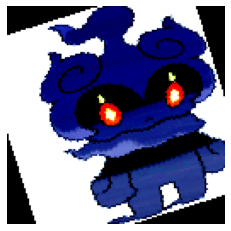

Номер элемента: 18
Истинный класс: Persian
Beedrill (12.31%)
Blaziken (10.85%)
Kabutops (10.21%)


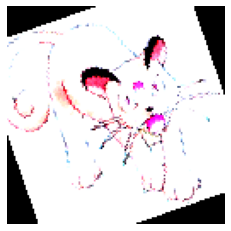

Номер элемента: 19
Истинный класс: Grimer
Grimer (30.66%)
Ekans (25.56%)
Toxtricity (11.28%)


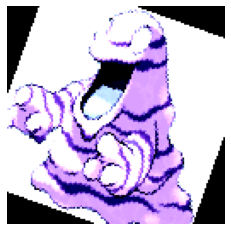

Номер элемента: 20
Истинный класс: Zorua
Gliscor (38.41%)
Zoroark (37.91%)
Hydreigon (17.20%)


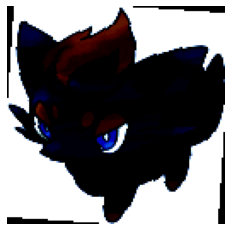

Номер элемента: 21
Истинный класс: Gallade
Calyrex (72.69%)
Vibrava (13.72%)
Giratina (12.67%)


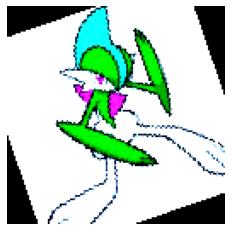

Номер элемента: 22
Истинный класс: Dracozolt
Drednaw (63.76%)
Croconaw (18.60%)
Zoroark (11.80%)


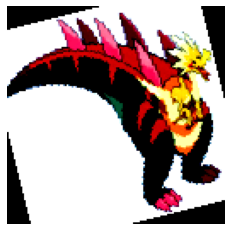

Номер элемента: 23
Истинный класс: Garchomp
Rowlet (56.84%)
Snorlax (20.50%)
Metagross (14.42%)


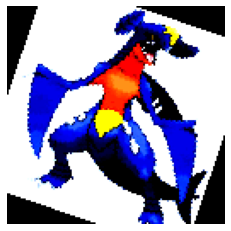

Номер элемента: 24
Истинный класс: Victini
Larvesta (46.25%)
Hoopa (19.12%)
Oricorio (7.85%)


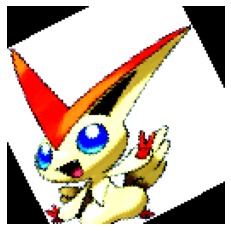

Номер элемента: 25
Истинный класс: Elgyem
Rayquaza (57.16%)
Kyurem (9.62%)
Cloyster (7.60%)


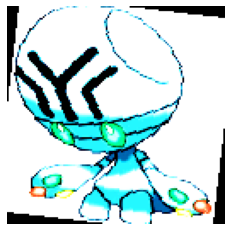

Номер элемента: 26
Истинный класс: Paras
Paras (95.98%)
Kingler (2.21%)
Hitmonchan (0.57%)


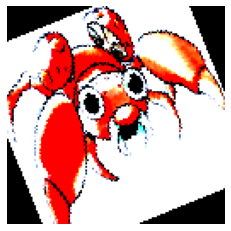

Номер элемента: 27
Истинный класс: Flabébé
Flabébé (72.51%)
Shaymin (26.17%)
Stantler (0.25%)


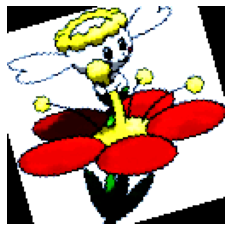

Номер элемента: 28
Истинный класс: Poliwag
Xerneas (60.65%)
Drampa (10.44%)
Aron (5.40%)


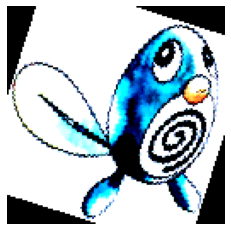

Номер элемента: 29
Истинный класс: Flaaffy
Nidoran♀ (33.76%)
Happiny (20.19%)
Litwick (15.97%)


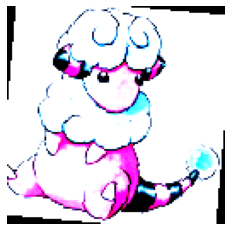

Номер элемента: 30
Истинный класс: Vulpix
Togekiss (40.07%)
Beartic (17.32%)
Mew (12.62%)


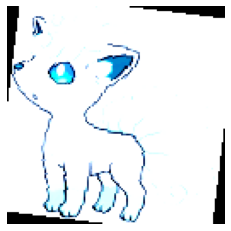

Номер элемента: 31
Истинный класс: Leavanny
Sunflora (70.90%)
Zapdos (22.61%)
Leavanny (3.36%)


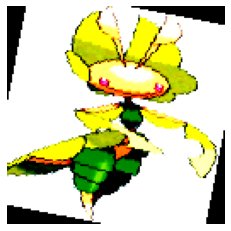

Номер элемента: 0
Истинный класс: Pachirisu
Pachirisu (98.27%)
Nihilego (0.60%)
Zubat (0.36%)


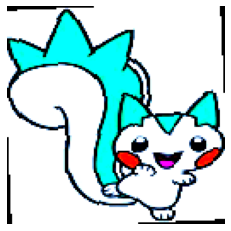

Номер элемента: 1
Истинный класс: Blacephalon
Altaria (65.94%)
Kingdra (19.58%)
Lapras (8.32%)


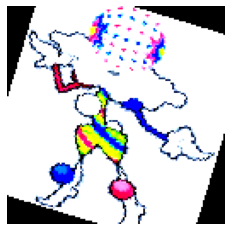

Номер элемента: 2
Истинный класс: Lunala
Lunala (98.91%)
Cleffa (0.36%)
Kecleon (0.33%)


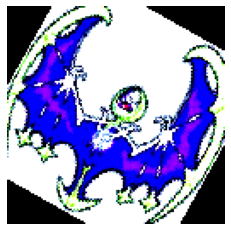

Номер элемента: 3
Истинный класс: Emboar
Conkeldurr (89.22%)
Emboar (6.88%)
Pikachu (1.77%)


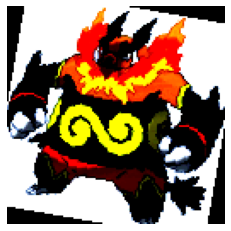

Номер элемента: 4
Истинный класс: Komala
Tornadus (57.52%)
Giratina (16.51%)
Komala (14.45%)


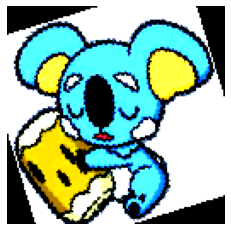

Номер элемента: 5
Истинный класс: Fletchling
Grovyle (27.02%)
Meowth (18.69%)
Litten (16.41%)


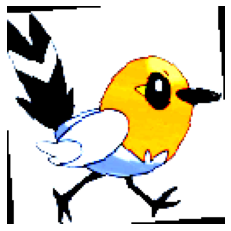

Номер элемента: 6
Истинный класс: Cloyster
Cloyster (12.71%)
Rhydon (12.66%)
Grimer (11.31%)


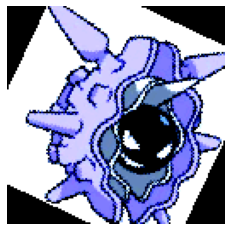

Номер элемента: 7
Истинный класс: Houndoom
Umbreon (78.91%)
Kyurem (15.18%)
Houndoom (2.65%)


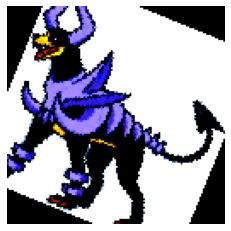

Номер элемента: 8
Истинный класс: Pawniard
Machoke (41.29%)
Meloetta (21.49%)
Arbok (5.54%)


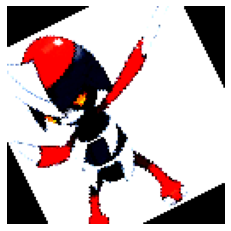

Номер элемента: 9
Истинный класс: Butterfree
Latias (65.37%)
Butterfree (13.17%)
Kyurem (5.90%)


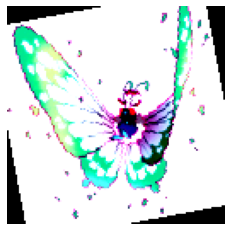

Номер элемента: 10
Истинный класс: Omanyte
Omanyte (91.91%)
Oshawott (6.06%)
Snorlax (2.02%)


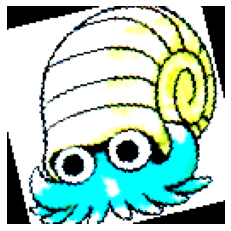

Номер элемента: 11
Истинный класс: Articuno
Rhydon (27.65%)
Rhyhorn (10.15%)
Palkia (8.93%)


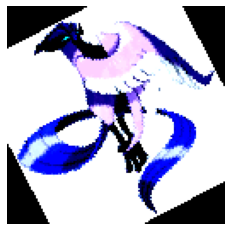

Номер элемента: 12
Истинный класс: Guzzlord
Lucario (74.32%)
Copperajah (21.47%)
Charjabug (2.79%)


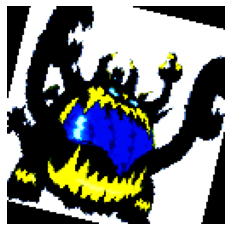

Номер элемента: 13
Истинный класс: Araquanid
Kyurem (24.10%)
Lairon (14.88%)
Umbreon (12.40%)


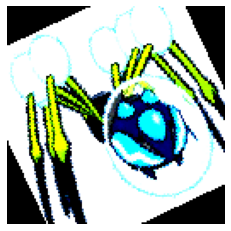

Номер элемента: 14
Истинный класс: Vanillish
Chinchou (99.52%)
Vanillish (0.29%)
Togepi (0.09%)


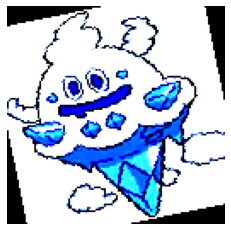

Номер элемента: 15
Истинный класс: Golduck
Golduck (14.65%)
Heracross (13.28%)
Marill (13.07%)


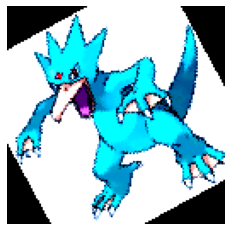

Номер элемента: 16
Истинный класс: Deerling
Steenee (64.68%)
Bellsprout (11.26%)
Dodrio (4.44%)


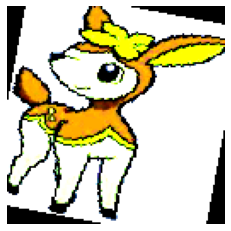

Номер элемента: 17
Истинный класс: Comfey
Comfey (95.60%)
Psyduck (3.12%)
Vivillon (0.31%)


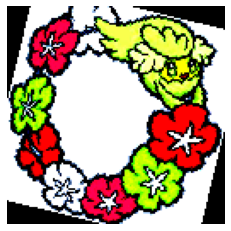

Номер элемента: 18
Истинный класс: Vivillon
Vivillon (95.77%)
Pichu (1.68%)
Cleffa (1.61%)


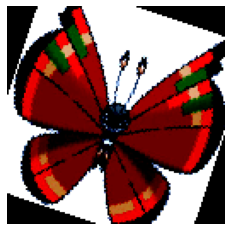

Номер элемента: 19
Истинный класс: Appletun
Flapple (46.24%)
Aromatisse (23.01%)
Volcanion (14.16%)


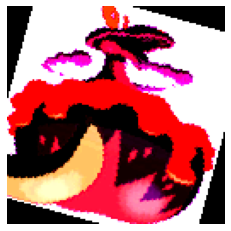

Номер элемента: 20
Истинный класс: Beartic
Dewgong (52.39%)
Seel (13.01%)
Goldeen (9.68%)


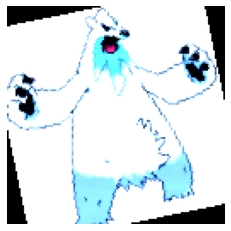

Номер элемента: 21
Истинный класс: Dugtrio
Diglett (43.48%)
Dugtrio (18.81%)
Piloswine (11.37%)


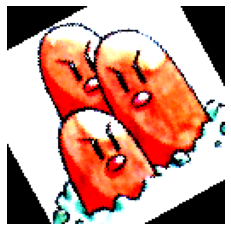

Номер элемента: 22
Истинный класс: Sunflora
Sunflora (99.77%)
Bellsprout (0.21%)
Raticate (0.01%)


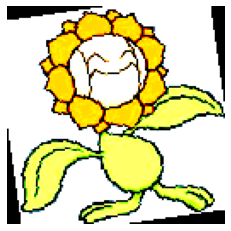

Номер элемента: 23
Истинный класс: Decidueye
Quilava (43.23%)
Cosmoem (10.19%)
Tyranitar (6.65%)


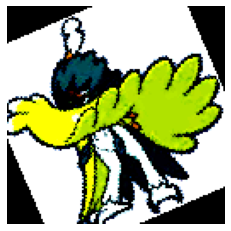

Номер элемента: 24
Истинный класс: Dedenne
Dedenne (98.92%)
Pichu (0.78%)
Tauros (0.12%)


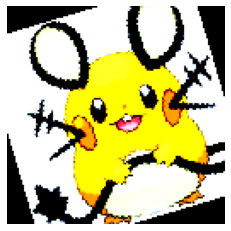

Номер элемента: 25
Истинный класс: Cascoon
Silcoon (79.86%)
Arceus (9.25%)
Shaymin (2.45%)


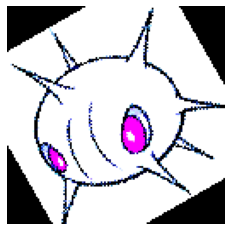

Номер элемента: 26
Истинный класс: Kingdra
Kingdra (86.00%)
Nidoran♂ (5.47%)
Nidoking (3.19%)


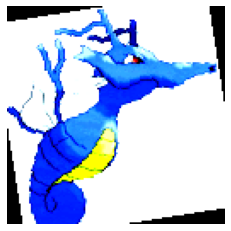

Номер элемента: 27
Истинный класс: Mareep
Litwick (94.04%)
Blipbug (2.49%)
Eelektrik (2.32%)


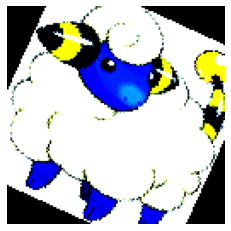

Номер элемента: 28
Истинный класс: Salandit
Type Null (45.44%)
Darkrai (36.23%)
Lairon (3.61%)


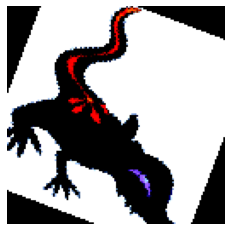

Номер элемента: 29
Истинный класс: Pinsir
Timburr (40.70%)
Lunatone (10.68%)
Shaymin (10.55%)


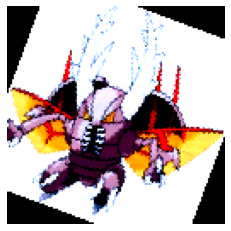

Номер элемента: 30
Истинный класс: Banette
Banette (69.70%)
Bastiodon (15.16%)
Zygarde (5.40%)


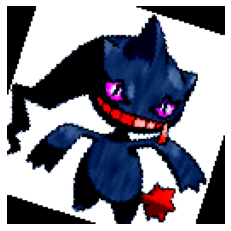

Номер элемента: 31
Истинный класс: Heatmor
Watchog (62.99%)
Pikachu (31.05%)
Kingler (0.77%)


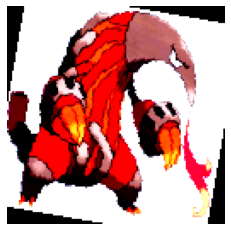

Номер элемента: 0
Истинный класс: Floette
Poliwhirl (98.76%)
Floette (1.03%)
Regigigas (0.09%)


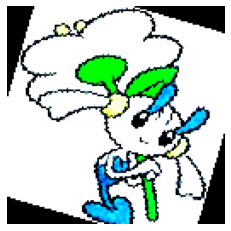

Номер элемента: 1
Истинный класс: Gallade
Scyther (53.77%)
Cacturne (21.11%)
Mamoswine (6.34%)


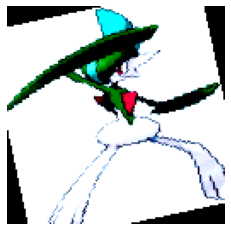

Номер элемента: 2
Истинный класс: Alakazam
Alakazam (38.15%)
Magikarp (17.67%)
Blaziken (11.43%)


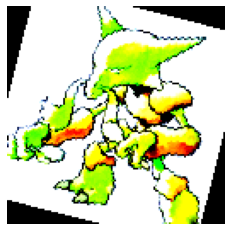

Номер элемента: 3
Истинный класс: Monferno
Keldeo (37.52%)
Charizard (23.16%)
Deoxys (19.76%)


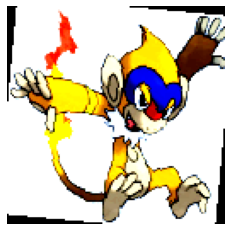

Номер элемента: 4
Истинный класс: Makuhita
Volcanion (46.23%)
Charizard (22.31%)
Floatzel (15.93%)


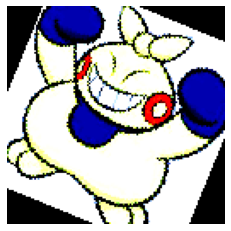

Номер элемента: 5
Истинный класс: Bagon
Stoutland (19.88%)
Whiscash (16.52%)
Thundurus (16.41%)


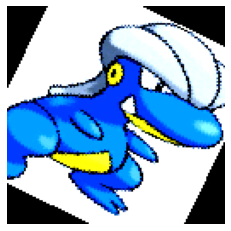

Номер элемента: 6
Истинный класс: Haxorus
Haxorus (61.94%)
Pikachu (21.51%)
Watchog (4.47%)


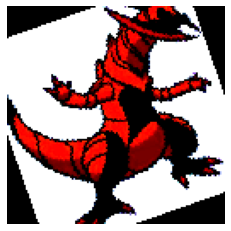

Номер элемента: 7
Истинный класс: Stantler
Combusken (51.92%)
Mankey (8.85%)
Baltoy (4.63%)


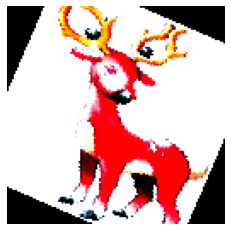

Номер элемента: 8
Истинный класс: Typhlosion
Deoxys (85.45%)
Machoke (9.81%)
Keldeo (0.98%)


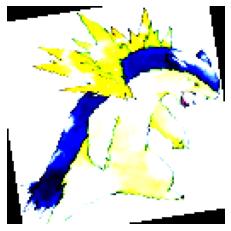

Номер элемента: 9
Истинный класс: Grotle
Grotle (61.50%)
Giratina (9.75%)
Torterra (8.99%)


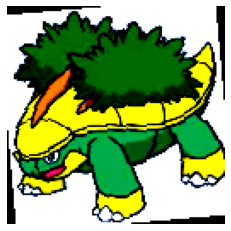

Номер элемента: 10
Истинный класс: Crobat
Crobat (99.99%)
Pachirisu (0.01%)
Aerodactyl (0.00%)


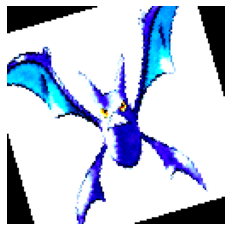

Номер элемента: 11
Истинный класс: Mienshao
Goodra (43.14%)
Mienshao (15.04%)
Tynamo (11.82%)


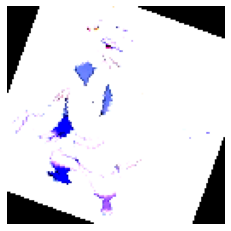

Номер элемента: 12
Истинный класс: Wimpod
Sliggoo (47.36%)
Shroomish (10.24%)
Wimpod (8.68%)


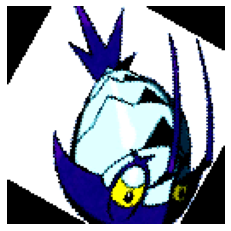

Номер элемента: 13
Истинный класс: Decidueye
Rotom (40.13%)
Tyranitar (34.72%)
Litten (8.86%)


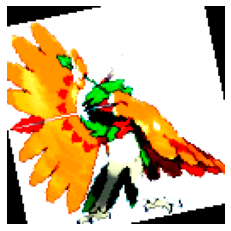

Номер элемента: 14
Истинный класс: Shuckle
Hoppip (86.21%)
Meganium (5.46%)
Scraggy (1.61%)


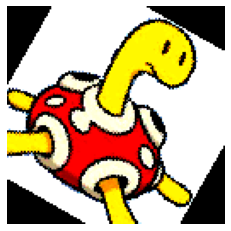

Номер элемента: 15
Истинный класс: Zekrom
Umbreon (89.56%)
Unfezant (6.72%)
Zekrom (2.19%)


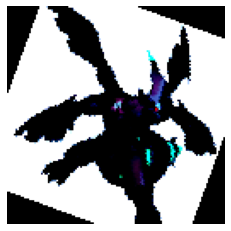

Номер элемента: 16
Истинный класс: Haunter
Kabutops (42.33%)
Starmie (42.14%)
Beedrill (4.42%)


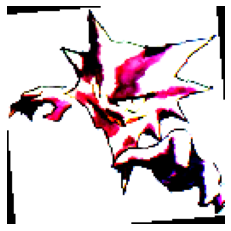

Номер элемента: 17
Истинный класс: Volcarona
Gastly (42.19%)
Kangaskhan (29.98%)
Shellos (6.24%)


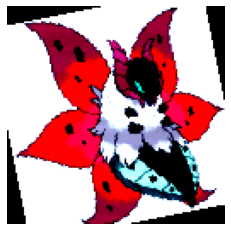

Номер элемента: 18
Истинный класс: Spiritomb
Charizard (75.10%)
Cleffa (14.84%)
Slowbro (3.76%)


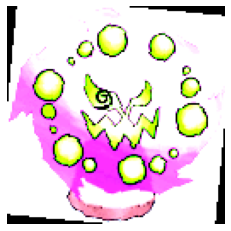

Номер элемента: 19
Истинный класс: Fennekin
Fennekin (93.40%)
Kakuna (1.75%)
Parasect (1.46%)


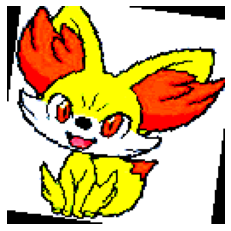

Номер элемента: 20
Истинный класс: Camerupt
Slowbro (30.35%)
Hoopa (22.11%)
Floatzel (10.59%)


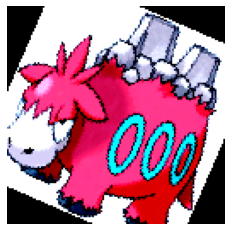

In [107]:
num_image = 0

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        probabilities = torch.nn.functional.softmax(outputs, dim=1)
        pred_probs, preds = torch.topk(probabilities, 3)

        class_names = full_dataset.classes

        for i in range(len(labels)):
            print(f"Номер элемента: {i}")
            print(f"Истинный класс: {class_names[labels[i].item()]}")
            for j in range(3):
                print(f"{class_names[preds[i][j].item()]} ({pred_probs[i][j].item():.2%})")

            img = images[i].cpu().numpy().transpose((1, 2, 0))
            plt.imshow(np.clip(img, 0, 1))
            plt.axis('off')
            plt.show()

Выводы:

На данной моделе мы видим не лучшее качество, так как модель сильно проста для такого числа классов, расширение модели, использование резидуал слоев, дропаута и так далее, улучшило бы качество, но сильно увеличило время обучения и необходимый объем видеопамяти 